In [2]:

%pip uninstall -y ruclip
%pip install transformers --upgrade
%pip install tokenizers --upgrade
%pip install peft --upgrade
%pip install accelerate --upgrade
%pip install datasets --upgrade
%pip install huggingface_hub --upgrade --force-reinstall 
%pip install Cython setuptools wheel
%pip install ruclip --force-reinstall


Found existing installation: ruclip 0.0.2
Uninstalling ruclip-0.0.2:
  Successfully uninstalled ruclip-0.0.2
Note: you may need to restart the kernel to use updated packages.
  Using cached huggingface_hub-0.31.4-py3-none-any.whl.metadata (13 kB)
Using cached huggingface_hub-0.31.4-py3-none-any.whl (489 kB)
  Attempting uninstall: huggingface-hub
    Found existing installation: huggingface-hub 0.2.1
    Uninstalling huggingface-hub-0.2.1:
      Successfully uninstalled huggingface-hub-0.2.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
datasets 3.6.0 requires fsspec[http]<=2025.3.0,>=2023.1.0, but you have fsspec 2025.5.0 which is incompatible.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need 

In [4]:
import re
import glob


filename = "/workspace/AAA_project/venv/lib/python3.12/site-packages/ruclip/__init__.py"

with open(filename, "r", encoding="utf-8") as f:
    lines = f.readlines()

new_lines = []
for i, line in enumerate(lines):
    if i == 3 and "from huggingface_hub import" in line:
        new_lines.append("from huggingface_hub import hf_hub_url, hf_hub_download\n")
    if "cached_download(" in line:
        indent = re.match(r"^(\s*)", line).group(1)
        new_lines.append(
            indent +
            "hf_hub_download(repo_id=repo_id, filename=filename, cache_dir=cache_dir, "
            "force_filename=filename, use_auth_token=use_auth_token)\n"
        )
    if 'sberbank-ai' in line:
        new_lines.append(line.replace('sberbank-ai', 'ai-forever'))
    else:
        new_lines.append(line)

with open(filename, "w", encoding="utf-8") as f:
    f.writelines(new_lines)


for file in glob.glob("/workspace/AAA_project/venv/lib/python3.12/site-packages/**/file_download.py", recursive=True):
    with open(file, "r", encoding="utf-8") as f:
        lines = f.readlines()
    new_lines = []
    i = 0
    while i < len(lines):
        line = lines[i]
        match = re.match(r"^(\s*)if\s+etag\s+is\s+None\s*:", line)
        if match:
            indent = match.group(1)
            new_lines.append(f"{indent}if etag is None:\n")
            new_lines.append(f"{indent}    etag = None  # PATCH: skip ETag check for ruclip\n")
            i += 1
            while i < len(lines):
                if not lines[i].startswith(indent + "    ") and lines[i].strip():
                    break
                i += 1
            continue
        else:
            new_lines.append(line)
            i += 1
    with open(file, "w", encoding="utf-8") as f:
        f.writelines(new_lines)
    print("Блок if etag is None заменён на безопасный патч в:", file)


print('\n\n ПЕРЕЗАПУСТИТЬ ЯДРО!\n\n')

Блок if etag is None заменён на безопасный патч в: /workspace/AAA_project/venv/lib/python3.12/site-packages/huggingface_hub/file_download.py


 ПЕРЕЗАПУСТИТЬ ЯДРО!




In [ ]:
import ruclip
import torch
from PIL import Image
import pandas as pd
from tqdm import tqdm
import ast

import os

import numpy as np
import cv2
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import matplotlib.patches as patches
import random

import torch
from PIL import Image

DEVICE = "cuda" 

DATASET = '/workspace/AAA_project/data/main_dataset/meta_info.csv'
IMAGES = '/workspace/AAA_project/data/main_dataset/images/'

RANDOM_STATE = 42

In [2]:
df = pd.read_csv(DATASET)

In [3]:
def load_images_from_row(images_str):
    try:
        ids = ast.literal_eval(images_str) if isinstance(images_str, str) else []
        images = []
        for img_id in ids:
            img_path = os.path.join(IMAGES, f"{img_id}.jpg")
            if os.path.isfile(img_path):
                try:
                    images.append(Image.open(img_path).convert('RGB'))
                except Exception as e:
                    print(f'Ошибка открытия {img_path}: {e}')
                    images.append(None)
            else:
                images.append(None)
        return images
    except Exception as e:
        print(f'Ошибка парсинга {images_str}: {e}')
        return []


test_images = load_images_from_row(df.iloc[4]['images'])
print(test_images)

[<PIL.Image.Image image mode=RGB size=360x480 at 0x7676FAF85490>, <PIL.Image.Image image mode=RGB size=360x480 at 0x7676FD3C9CD0>, <PIL.Image.Image image mode=RGB size=360x480 at 0x7676FAF85A00>]


In [7]:
df

,item_id,title,description,attrs,images,category,other
0,1322715250286,Туфли Kapika р.30,Новые туфельки для девочки\n\nТМ Kapika \n\nВе...,"{'Вид одежды': 'Для девочек', 'Предмет одежды'...",[14797484977],(Ж) Обувь,"Туфли Kapika для девочек, размер 30 (19 см), в..."
1,1855325000254,Кеды adidas superstar детские,"Продаю кеды адидас, оригинал, покупались в офл...","{'Предмет одежды': 'Обувь', 'Вид одежды': 'Для...","[29690495353, 29690495386, 29690495401, 296904...",(М) Обувь,Продаю детские кеды adidas Superstar белого цв...
2,1779415000905,Кросовки 27 размер для девочки,Кросовки для девочки от Загадка в хорошем сост...,"{'Вид одежды': 'Для девочек', 'Предмет одежды'...","[27889651299, 27889651322, 27889651235, 278896...",(Ж) Обувь,"Яркие разноцветные кроссовки для девочки, разм..."
3,1817738751606,Crocs сабо детские35-36/3-5 оригинал,"Состояние отличное, дефект единственный на фот...","{'Вид одежды': 'Для девочек', 'Предмет одежды'...","[28909766974, 28909767030, 28909767120, 289097...",(Ж) Обувь,Продаются оригинальные детские сабо Crocs в яр...
4,1863482000525,Ботинки детские Tombi 26 размер,"Ботиночки Tombi,в стиле Timberland,очень удобн...","{'Предмет одежды': 'Обувь', 'Вид одежды': 'Для...","[29898615047, 29898615057, 29898615186]",(М) Обувь,"Продаются детские ботинки Tombi 26 размера, ко..."
...,...,...,...,...,...,...,...
37436,1663653000236,Кофточки 122,Кофточки для школы.\nЧерная с жемчугом и синяя...,"{'Вид одежды': 'Для девочек', 'Предмет одежды'...","[29413588886, 29413589167]",(Ж) Блузки и рубашки,Продаю стильные кофточки для девочек от бренда...
37437,1670162501379,Футболка и толстовка для мальчика 152см,Вещи пакетом на мальчика. На рост 152см. Вещи ...,"{'Предмет одежды': 'Футболки и майки', 'Вид од...","[26299714558, 29298404644, 29307635580, 293076...",(М) Футболки и майки,Продаю комплект одежды для мальчика на рост 15...
37438,1676625251053,Хлопковая фланелевая рубашка hm 68,Новая хлопковая фланелевая рубашка H&M 🇩🇪\n\nC...,"{'Предмет одежды': 'Рубашки', 'Вид одежды': 'Д...","[25538038858, 25538039948]",(М) Рубашки,Новая хлопковая фланелевая рубашка H&M для мал...
37439,1320192252110,Рубашка для мальчика 140,Рубашка голубого цвета длина рукава 51 ширина ...,"{'Предмет одежды': 'Рубашки', 'Вид одежды': 'Д...",[14744548373],(М) Рубашки,Продаётся новая голубая рубашка для мальчика. ...


### Поиск главной картинки в объявлении

In [8]:
def make_full_text(row):
    parts = []
    if 'title' in row and pd.notnull(row['title']):
        parts.append(str(row['title']))
    if 'description' in row and pd.notnull(row['description']):
        parts.append(str(row['description']))
    if 'category' in row and pd.notnull(row['category']):
        parts.append(f"Категория: {row['category']}")
    if 'attrs' in row and pd.notnull(row['attrs']):
        if isinstance(row['attrs'], dict):
            attrs_str = ', '.join([f"{k}: {v}" for k, v in row['attrs'].items()])
        else:
            try:
                attrs_dict = ast.literal_eval(row['attrs'])
                attrs_str = ', '.join([f"{k}: {v}" for k, v in attrs_dict.items()])
            except Exception:
                attrs_str = str(row['attrs'])
        parts.append(f"Атрибуты: {attrs_str}")
    return " | ".join(parts)

make_full_text(df.iloc[4])


'Ботинки детские Tombi 26 размер | Ботиночки Tombi,в стиле Timberland,очень удобные ,комфортные и тёплые.Отличный вариант на осень ,внутри байка.Ребенок надел один раз ,состояние идеальное | Категория: (М) Обувь | Атрибуты: Предмет одежды: Обувь, Вид одежды: Для мальчиков, Вид объявления: Продаю своё, Цвет: Коричневый, Размер: 26 (16,5 см), Бренд одежды: Tombi, Вид обуви: Ботинки и туфли, Тип обуви: Ботинки, Как часто надевали?: Один раз'

In [14]:
def select_main_image(row, predictor):
    images = load_images_from_row(row['images'])
    images = [img for img in images if img is not None]
    if not images:
        return None
    if len(images) == 1:
        try:
            image_ids = ast.literal_eval(row['images'])
        except Exception:
            image_ids = row['images']
        return image_ids[0] if isinstance(image_ids, list) else None
    text = make_full_text(row)
    with torch.no_grad():
        text_latents = predictor.get_text_latents([text])  # shape [1, dim]
        image_latents = predictor.get_image_latents(images)  # shape [N, dim]

        sims = (image_latents @ text_latents.T).squeeze(1)  # shape [N]
        idx = int(sims.argmax().item())
        try:
            image_ids = ast.literal_eval(row['images'])
        except Exception:
            image_ids = row['images']
        if isinstance(image_ids, list) and len(image_ids) > idx:
            return image_ids[idx]
        else:
            return None


In [18]:
# 'ruclip-vit-base-patch32-224'
# 'ruclip-vit-base-patch16-224'
# 'ruclip-vit-large-patch14-224'
# 'ruclip-vit-large-patch14-336'
# 'ruclip-vit-base-patch32-384'
# 'ruclip-vit-base-patch16-384'


clip, processor = ruclip.load('ruclip-vit-base-patch32-384', device=DEVICE)
predictor = ruclip.Predictor(clip, processor, DEVICE)

Downloading:   0%|          | 0.00/748k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/346 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/606M [00:00<?, ?B/s]

In [20]:
tqdm.pandas(desc="Выбор главной картинки")

df_samp = df.sample(300, random_state=RANDOM_STATE)
df_samp['main_img'] = df_samp.progress_apply(lambda row: select_main_image(row, predictor), axis=1)
# df['main_img'] = df.progress_apply(lambda row: select_main_image(row, predictor), axis=1)

Выбор главной картинки:   0%|          | 0/300 [00:00<?, ?it/s]


2it [00:00, 142.40it/s]

2it [00:00, 134.80it/s]

4it [00:00, 79.29it/s]

4it [00:00, 82.49it/s]

3it [00:00, 63.30it/s]

3it [00:00, 57.76it/s]

2it [00:00, 141.88it/s]

2it [00:00, 133.82it/s]

3it [00:00, 147.50it/s]

5it [00:00, 126.91it/s]

3it [00:00, 162.89it/s]

3it [00:00, 72.29it/s]

4it [00:00, 77.02it/s]

4it [00:00, 78.80it/s]

2it [00:00, 44.64it/s]

2it [00:00, 135.00it/s]

4it [00:00, 187.54it/s]

3it [00:00, 180.34it/s]

3it [00:00, 179.40it/s]

4it [00:00, 81.18it/s]

2it [00:00, 48.91it/s]

3it [00:00, 171.94it/s]

5it [00:00, 83.70it/s]

3it [00:00, 164.36it/s]

3it [00:00, 184.51it/s]

3it [00:00, 169.60it/s]

5it [00:00, 207.72it/s]

5it [00:00, 200.53it/s]

4it [00:00, 168.58it/s]

2it [00:00, 128.77it/s]

5it [00:00, 179.11it/s]

4it [00:00, 156.56it/s]

4it [00:00, 199.83it/s]

5it [00:00, 193.69it/s]

2it [00:00, 156.34it/s]

2it [00:00, 131.82it/s]

5it [00:00, 82.15it/s]

3it [00:00, 66.95it/s]

3it [00:00, 59.30it/s]

2it [00:00, 39.19it/s]

3it [00:00, 19

In [21]:
df_samp

,item_id,title,description,attrs,images,category,other,main_img
36733,1863865000337,Рубашка в клетку размер 110,Рубашка в клетку для мальчика размер 110. Сост...,"{'Предмет одежды': 'Рубашки', 'Вид одежды': 'Д...","[29903535170, 29903535184]",(М) Рубашки,"Стильная рубашка в клетку для мальчика, размер...",29903535170
18270,1857660501263,Школьные брюки для мальчика 122,Продам школьные брюки для мальчика на рост 122...,"{'Предмет одежды': 'Брюки', 'Вид одежды': 'Брю...","[29764433546, 29764433222]",(М) Брюки,Продаются школьные брюки для мальчика на рост ...,29764433546
17751,1850913500620,Лосины foxy 98,"В отличном состоянии, дочка носила на физкульт...","{'Вид одежды': 'Лосины и леггинсы', 'Предмет о...",[29571160438],(Ж) Брюки,"Лосины FOX для детей 3 лет, размер 98 см. Элас...",29571160438
3100,1852602751239,Бутсы футбольные Nike р-р 36,Футбольные бутсы для подростка Nike Mercurial....,"{'Предмет одежды': 'Обувь', 'Вид одежды': 'Для...","[29625738907, 29625738844, 29625738906, 296257...",(М) Обувь,Футбольные бутсы Nike Mercurial в ярком красно...,29625738844
25990,1761584250583,"Футболка на физкультуру новая, Лицей 1, рост 152","новая футболка на физкультуру, даже не открыва...","{'Предмет одежды': 'Футболки и майки', 'Вид од...","[29501057068, 29501057116, 29501057107, 295010...",(М) Футболки и майки,"Новая зелёная футболка для мальчиков, идеально...",29501057068
...,...,...,...,...,...,...,...,...
19734,1721043500935,Вельветовые теплые брюки для девочки 110,Новые вельветовые теплые брюки- бананы для дев...,"{'Вид одежды': 'Брюки', 'Предмет одежды': 'Брю...",[26682905622],(Ж) Брюки,"Новые вельветовые брюки для девочки, размер 11...",26682905622
22413,1720588751054,Кардиган Dior для девочки 68-74,"Размер указан 6М, мы носили до полутора лет , ...","{'Вид одежды': 'Кофты', 'Предмет одежды': 'Сви...","[26666649080, 26666829392, 26666830633]",(Ж) Свитеры и толстовки,Очаровательный кардиган для девочки от Christi...,26666649080
5100,1854980750028,Детский зимний комбинезонн на девочку 104 размер,"очень хороший зимний костюмчик на 4 года, разм...","{'Вид одежды': 'Утеплённые комбинезоны', 'Пред...","[29680546407, 29680546340, 29680546401, 296805...",(Ж) Комбинезоны,Продаётся детский зимний комбинезон для девочк...,29680546402
37139,1848501250471,Mayoral футболка 152,Красивая и эффектная футболка фирмы Mayoral. ...,"{'Вид одежды': 'Футболки', 'Предмет одежды': '...","[29502978693, 29502979290, 29502979985]",(Ж) Футболки и топы,Стильная синяя футболка Mayoral для детей рост...,29502979985



--- Объявление 1 (index=3780) ---
Title: Комбинезон
Description: Продаю детский комбинезон весна/осень размер 56-62. НОВЫЙ! одевали 1 раз всего. На погоду от +15 до 0. Ручки открываются/закрываются. Подкладка хлопковый трикотаж. Утеплитель бамбуковое волокно. Водоотталкивающая ткань.
Category: (Ж) Комбинезоны
Attrs: {'Вид одежды': 'Утеплённые комбинезоны', 'Предмет одежды': 'Комбинезоны', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Серый', 'Размер. Одежда': '56 см (2 мес.)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх, Низ'}


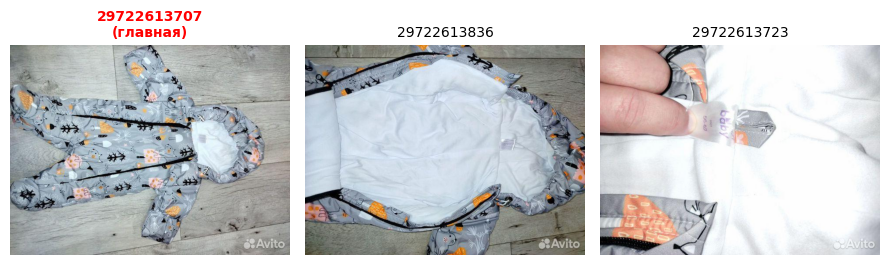


--- Объявление 2 (index=1174) ---
Title: Кроссовки Fila на 35 размер
Description: Продаю кроссовки Fila на 35 размер. Состояние хорошее. Посмотреть можно в районе Горького, Сельма, Светлогорск, Пионерский.
Category: (Ж) Обувь
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Обувь', 'Вид объявления': 'Продаю своё', 'Размер': '35 (22,5 см)', 'Бренд одежды': 'Fila', 'Вид обуви': 'Кроссовки и кеды'}


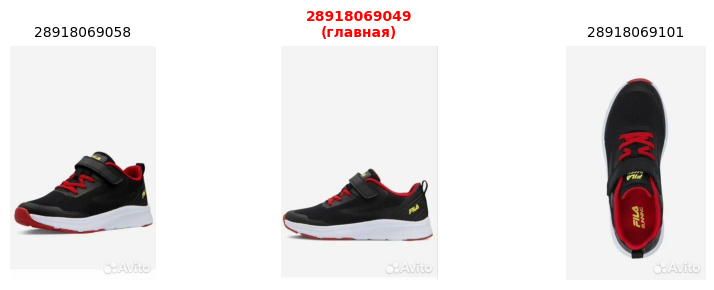


--- Объявление 3 (index=8310) ---
Title: Ветровка на мальчика
Description: Продам ветровку на мальчика рост 120-125см. В хорошем состоянии, без потертостей. Длина ветровки  53см, рукав от плеча 43 см.
Category: (М) Верхняя одежда
Attrs: {'Предмет одежды': 'Верхняя одежда', 'Вид одежды': 'Куртки и пуховики', 'Вид объявления': 'Продаю своё', 'Цвет': 'Зелёный', 'Размер. Одежда': '122 см (7 лет)', 'Бренд одежды': 'Oldos', 'Материал': 'Хлопок', 'Тип предмета одежды': 'Верх', 'Тип одежды': 'Ветровка', 'Как часто надевали?': 'Несколько раз'}


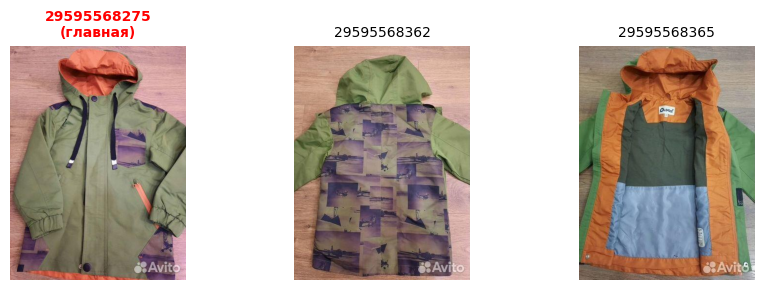


--- Объявление 4 (index=28102) ---
Title: Рубашка белая
Description: продам белую рубашку, одевали 1 раз, на первое сентября, качество хорошее, не мнётся рост 140-146, 600 руб
Category: (М) Рубашки
Attrs: {'Предмет одежды': 'Рубашки', 'Вид одежды': 'Для мальчиков', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Белый', 'Размер. Одежда': '140 см (10 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх'}


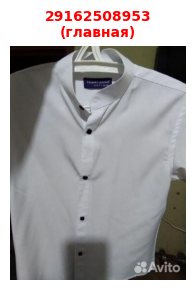


--- Объявление 5 (index=10853) ---
Title: Платье, кофты 116-122 р
Description: хорошее состояние, дырочек нет, три платья с рукавами по 150 р. , кофта платье  хлопок, очень приятная к телу 200 р. 116 р., бежевая кофта с укороченными рукавами очень стильно смотрится, быстро переросли не носили практически 116 р. 200 р, всё вместе за 700 р.
Category: (Ж) Платья и юбки
Attrs: {'Вид одежды': 'Платья', 'Предмет одежды': 'Платья и юбки', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Размер. Одежда': '116 см (6 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх, Низ'}


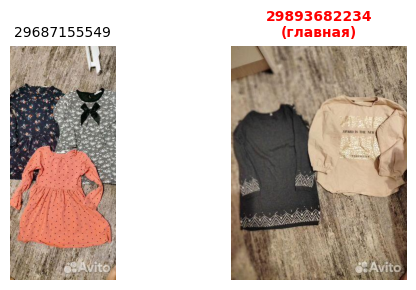


--- Объявление 6 (index=8057) ---
Title: Бомбер ветровка лето-весна для мальчика
Description: Замечательный яркий брендовыйбомбер для мальчика, альтернатива джинсовке. Состояние идеальное . Носить можно с 5 лет. Оригинал
Category: (М) Верхняя одежда
Attrs: {'Предмет одежды': 'Верхняя одежда', 'Вид одежды': 'Куртки и пуховики', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '116 см (6 лет)', 'Бренд одежды': 'Polo Ralph Lauren', 'Материал': 'Хлопок', 'Сезон': 'Лето', 'Утеплитель': 'Без утеплителя', 'Тип предмета одежды': 'Верх'}


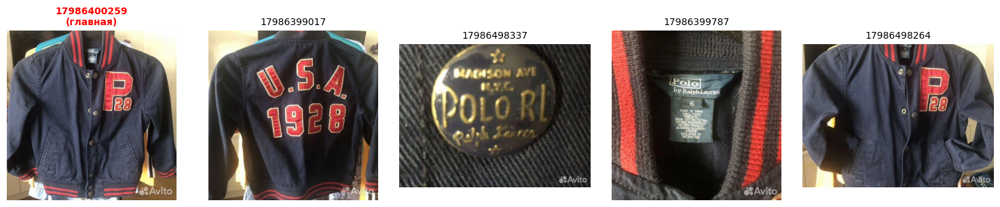


--- Объявление 7 (index=5199) ---
Title: Комбинезон флис 76-83
Description: Отличный лёгкий флисовый комбез, написано на 1.5 года, сыну хорошо было на рост от 78 до 83 см примерно) Хорош и как поддева, и как самостоятельный костюм)
По запросу сделаю замеры)
Динозавры, капюшон, хаки
Category: (М) Комбинезоны
Attrs: {'Предмет одежды': 'Комбинезоны', 'Вид одежды': 'Нательные комбинезоны', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Размер. Одежда': '80 см (12 мес.)', 'Бренд одежды': 'Без бренда', 'Тип предмета одежды': 'Верх, Низ'}


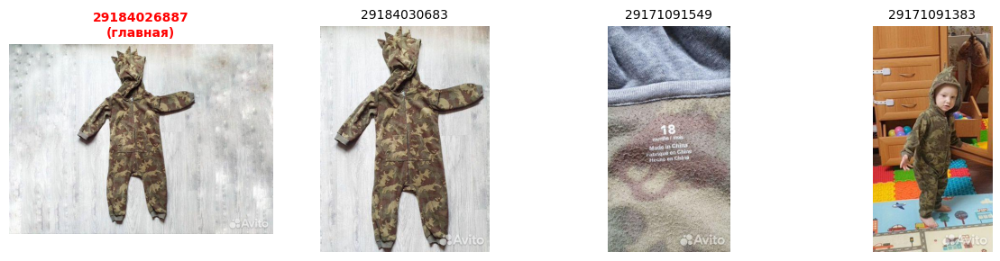


--- Объявление 8 (index=15912) ---
Title: Пиджак для мальчика
Description: Пиджак для мальчика . Качество отличное , состояние тоже. Следов носки нет. Одевали 1 раз  на фотосессию .  Размер 86
Category: (М) Пиджаки и костюмы
Attrs: {'Предмет одежды': 'Пиджаки и костюмы', 'Вид одежды': 'Пиджаки', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Размер. Одежда': '80 см (12 мес.)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх, Низ'}


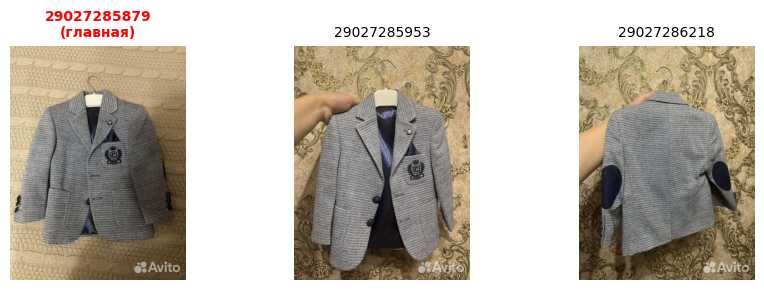


--- Объявление 9 (index=36581) ---
Title: Блузка школьная
Description: Блузка подойдет на рост 146-152,отличное состояние. Размеры: рукав+плечо-65см, ширина-38, длина по спинке-54см.
Category: (Ж) Блузки и рубашки
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Блузки и рубашки', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Белый', 'Размер. Одежда': '152 см (12 лет)', 'Бренд одежды': 'Без бренда', 'Тип предмета одежды': 'Верх'}


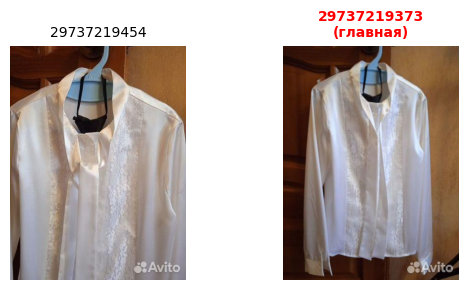


--- Объявление 10 (index=29272) ---
Title: Рубашка
Description: Рубашка для школы и не только. Состояние отличное. Длина рубашки 63 см, от подмышки до подмышки 47 см. Ростовка стоит  s.(46 ).Фасон прямая, не приталенная.
Category: (М) Рубашки
Attrs: {'Предмет одежды': 'Рубашки', 'Вид одежды': 'Для мальчиков', 'Вид объявления': 'Продаю своё', 'Размер. Одежда': '164 см (14 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх', 'Состояние от Авито': 'Как новое'}


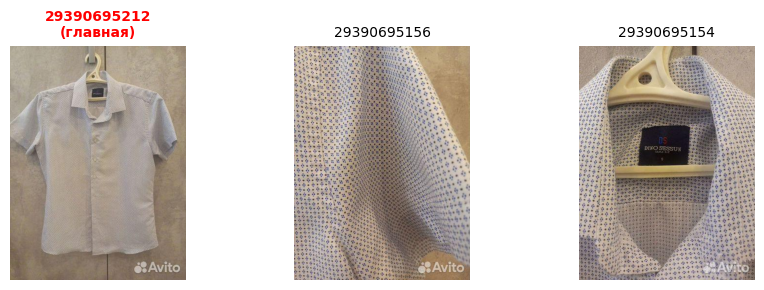


--- Объявление 11 (index=3899) ---
Title: Конверт - комбинезон
Description: Размер 56-62. После роддома пару раз надевали в поликлинику, быстро выросли и были другие комбинезончики этого размера, поэтому конвертик как новый)
Category: (Ж) Комбинезоны
Attrs: {'Вид одежды': 'Утеплённые комбинезоны', 'Предмет одежды': 'Комбинезоны', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Розовый', 'Размер. Одежда': '56 см (2 мес.)', 'Бренд одежды': 'Youlala', 'Тип предмета одежды': 'Верх, Низ'}


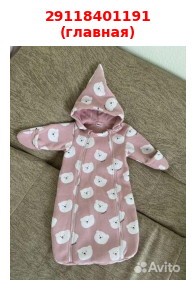


--- Объявление 12 (index=8322) ---
Title: Парка зимняя для мальчика рост 122-128
Description: Очень качественная, тёплая парка на мальчика. Рост 122-128 (7-8 лет). Со светоотражающими вставками. Состояние хорошее, за исключением одной отсутствующей клёпки на кармане (см.фото).
Category: (М) Верхняя одежда
Attrs: {'Предмет одежды': 'Верхняя одежда', 'Вид одежды': 'Куртки и пуховики', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Бордовый', 'Размер. Одежда': '128 см (8 лет)', 'Бренд одежды': 'Orby', 'Сезон': 'Зима', 'Утеплитель': 'С утеплителем', 'Особенности': 'Светоотражающие детали, Капюшон', 'Тип предмета одежды': 'Верх', 'Тип одежды': 'Парка'}


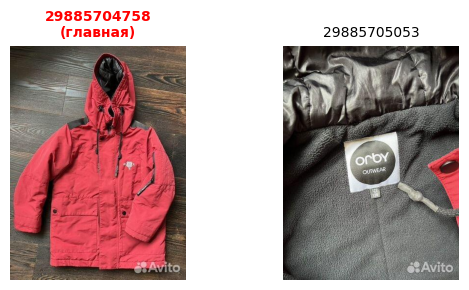


--- Объявление 13 (index=10927) ---
Title: Платье боди для девочки 74
Description: Очень красивое платье боди для девочки, насыщенного зеленого цвета.
Размер 74, на 6-9 месяцев. 
Без дефектов.
Category: (Ж) Платья и юбки
Attrs: {'Вид одежды': 'Платья', 'Предмет одежды': 'Платья и юбки', 'Вид объявления': 'Продаю своё', 'Цвет': 'Зелёный', 'Размер. Одежда': '74 см (9 мес.)', 'Бренд одежды': 'Без бренда', 'Тип предмета одежды': 'Верх, Низ'}


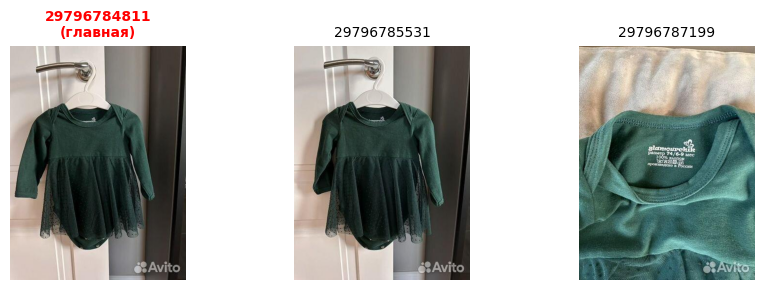


--- Объявление 14 (index=4634) ---
Title: Зимний комбинезон 80
Description: Продаю зимний комбинезон с коконом, очень теплый. В отличном состоянии.
Покупался на выписку в январе с запасом.
Category: (М) Комбинезоны
Attrs: {'Предмет одежды': 'Комбинезоны', 'Вид одежды': 'Утеплённые комбинезоны', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Серый', 'Размер. Одежда': '80 см (12 мес.)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх, Низ'}


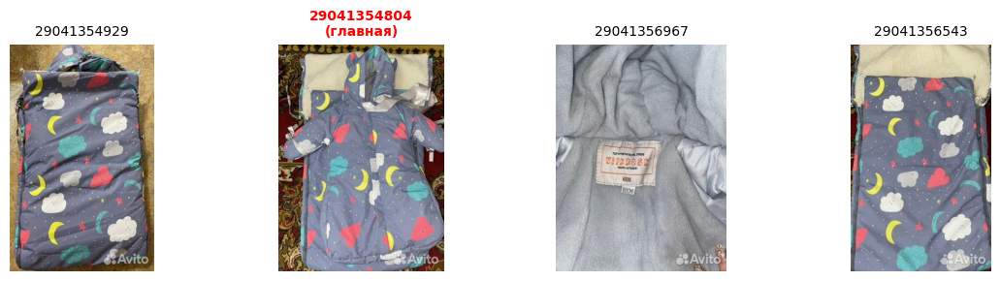


--- Объявление 15 (index=18458) ---
Title: Джинсы утеплённые, Maag 122p
Description: Джинсы утеплённые , Maag 122p
Есть утягивающая резинка
Новые ! С биркой
!!!Отправка Яндекс или 5post!
Category: (Ж) Брюки
Attrs: {'Вид одежды': 'Джинсы', 'Предмет одежды': 'Брюки', 'Состояние': 'Новый', 'Вид объявления': 'Продаю своё', 'Размер. Одежда': '122 см (7 лет)', 'Бренд одежды': 'Без бренда', 'Тип предмета одежды': 'Низ'}


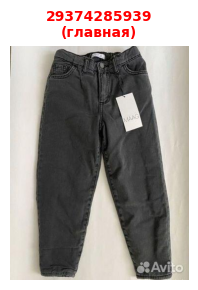


--- Объявление 16 (index=11489) ---
Title: Платье детское праздничное р 104
Description: Нарядное платье для девочки. В хорошем состоянии, надевали только на праздники. 
Длина примерно 55 см.
Category: (Ж) Платья и юбки
Attrs: {'Вид одежды': 'Платья', 'Предмет одежды': 'Платья и юбки', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Розовый', 'Размер. Одежда': '104 см (4 года)', 'Бренд одежды': 'Vulpes', 'Тип предмета одежды': 'Верх, Низ'}


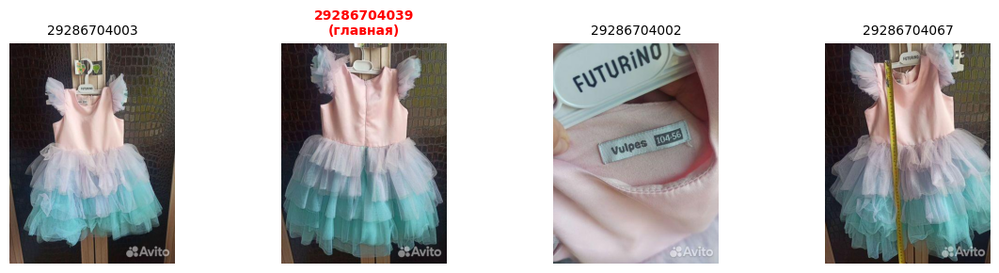


--- Объявление 17 (index=928) ---
Title: Унтоваленки фома
Description: Унтоваленки фома, в очень хорошем состоянии, стелька не вынимается, по подошве 20 см, очень телые,  внутри натуральный мех
Category: (М) Обувь
Attrs: {'Предмет одежды': 'Обувь', 'Вид одежды': 'Для мальчиков', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Розовый', 'Размер': '29 (18,5 см)', 'Бренд одежды': 'Фома', 'Вид обуви': 'Сапоги и полусапоги', 'Тип обуви': 'Унты'}


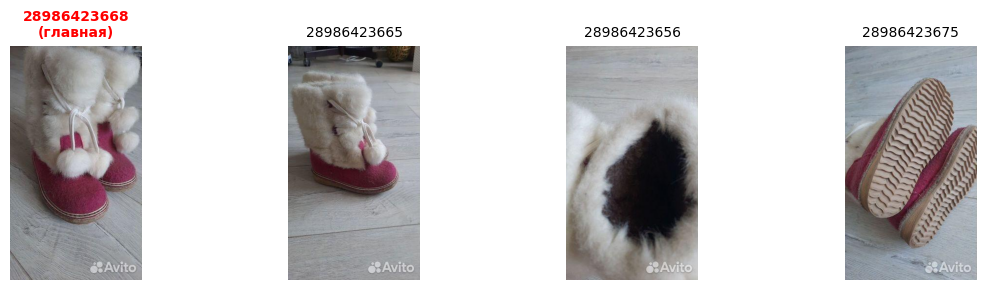


--- Объявление 18 (index=14137) ---
Title: Вечернее платье для девочек
Description: Продается праздничное детское платье розово-фиолетового цвета для девочки на рост 140-146 см. 
Это платье украшено паетками. 
Платье находится в хорошем состоянии. Платье идеально подходит для праздников, торжеств и особых случаев.
Category: (Ж) Платья и юбки
Attrs: {'Вид одежды': 'Платья', 'Предмет одежды': 'Платья и юбки', 'Вид объявления': 'Продаю своё', 'Цвет': 'Розовый', 'Размер. Одежда': '140 см (10 лет)', 'Бренд одежды': 'Без бренда', 'Тип предмета одежды': 'Верх, Низ', 'Как часто надевали?': 'Несколько раз', 'Дефекты основная часть': 'Небольшие пятна'}


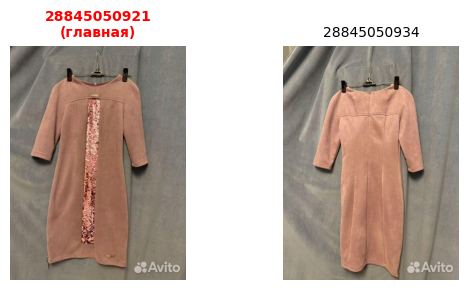


--- Объявление 19 (index=37013) ---
Title: Поло для мальчика
Description: поло для мальчиков р. от 152- 164, синяя темно на р.164, голубая м., белая р.152, серая импортная р.164.  цена каждая 400
Category: (М) Футболки и майки
Attrs: {'Предмет одежды': 'Футболки и майки', 'Вид одежды': 'Для мальчиков', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Разноцветный', 'Размер. Одежда': '158 см (13 лет)', 'Бренд одежды': 'Zara', 'Тип предмета одежды': 'Верх', 'Тип одежды': 'Поло', 'Что сохранилось?': 'Бирки, Ярлыки', 'Как часто надевали?': 'Несколько раз', 'Дефекты основная часть': 'Следы носки'}


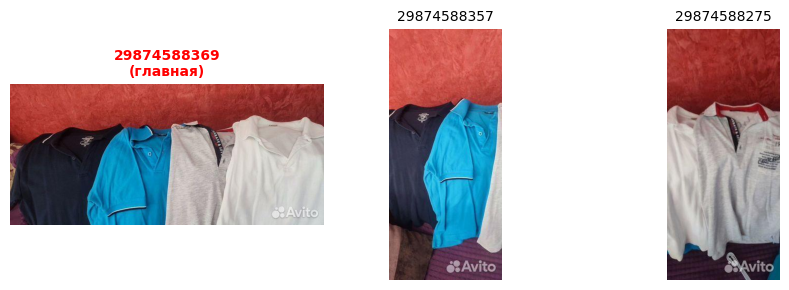


--- Объявление 20 (index=24750) ---
Title: Жилет школьный трикотажный р. 128
Description: Трикотажный жилет для школы зелёный, с V- образным вырезом. Брэнд Старт (школьная качественная одежда) . Размер 128/32, длина 47 см. 
Состав- 50% хлопок, 50% ПАН. 
Без бирок, состояние отличное.
Category: (М) Свитеры и толстовки
Attrs: {'Предмет одежды': 'Свитеры и толстовки', 'Вид одежды': 'Свитеры', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Зелёный', 'Размер. Одежда': '128 см (8 лет)', 'Бренд одежды': 'Старт', 'Тип предмета одежды': 'Верх', 'Тип одежды': 'Жилетка'}


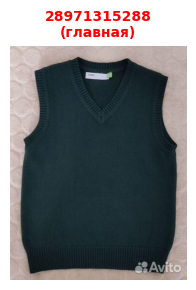


--- Объявление 21 (index=30465) ---
Title: Рубашка для мальчика 146
Description: Рубашки новенькие, получала, как многодетная, с Тверской фабрики. Не успели сносить. Пошив отличный, аккуратный. Есть брюки классические. Причина продажи - уход из школы в гимназию, где не нужна форма ) Лежат без дела. Забирайте )
Category: (М) Рубашки
Attrs: {'Предмет одежды': 'Рубашки', 'Вид одежды': 'Для мальчиков', 'Состояние': 'Новый', 'Вид объявления': 'Продаю своё', 'Цвет': 'Голубой', 'Размер. Одежда': '146 см (11 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх'}


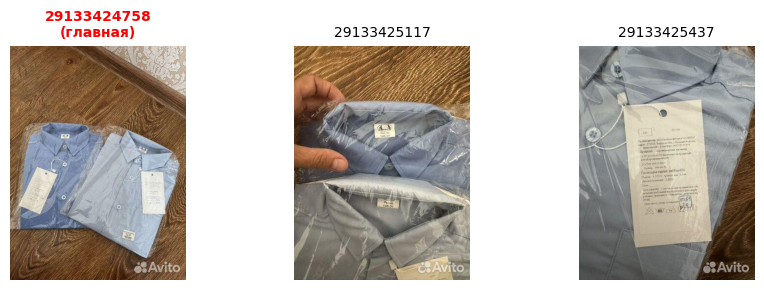


--- Объявление 22 (index=32827) ---
Title: Рубашка сорочка школьная Гулливер Gulliver 134+
Description: Рубашка сорочка школьная Гулливер 
Gulliver 134+
Фактурная красивая рубашка, сидит отлично. Приталенная, слим 
Подойдёт стройному мальчику. 
Состояние отличное, одевали пару раз.
Category: (М) Рубашки
Attrs: {'Предмет одежды': 'Рубашки', 'Вид одежды': 'Для мальчиков', 'Состояние': 'Как новое', 'Вид объявления': 'Продаю своё', 'Цвет': 'Белый', 'Размер. Одежда': '134 см (9 лет)', 'Бренд одежды': 'Gulliver', 'Тип предмета одежды': 'Верх', 'Состояние от Авито': 'Как новое'}


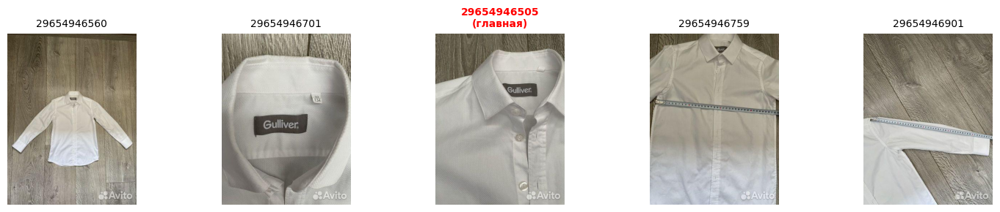


--- Объявление 23 (index=26040) ---
Title: Футболка для девочки
Description: Футболка для девочки-подростка. Надевала девочка 11 лет. Немного б/у. В отличном состоянии. Размер М, рост 164. Оверсайз.
Category: (Ж) Футболки и топы
Attrs: {'Вид одежды': 'Футболки', 'Предмет одежды': 'Футболки и топы', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Фиолетовый', 'Размер. Одежда': '164 см (14 лет)', 'Бренд одежды': 'Gloria Jeans', 'Тип предмета одежды': 'Верх'}


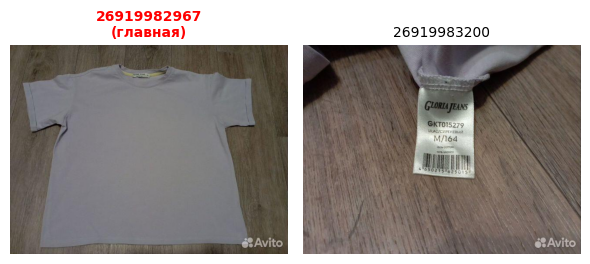


--- Объявление 24 (index=3100) ---
Title: Бутсы футбольные Nike р-р 36
Description: Футбольные бутсы для подростка Nike Mercurial. Оригинальные. 36 размер. Длина стельки примерно 22,5-23см. В очень хорошем состоянии. На узкую ногу.
Category: (М) Обувь
Attrs: {'Предмет одежды': 'Обувь', 'Вид одежды': 'Для мальчиков', 'Вид объявления': 'Продаю своё', 'Цвет': 'Красный', 'Размер': '36 (23 см)', 'Бренд одежды': 'Nike', 'Вид обуви': 'Спортивная обувь', 'Что сохранилось?': 'Бирки', 'Как часто надевали?': 'Регулярно', 'Дефекты основная часть': 'Мелкие потёртости'}


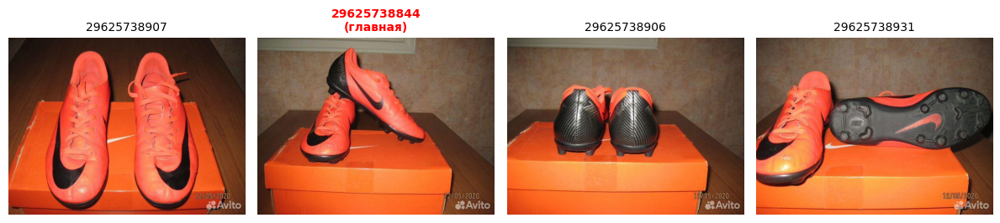


--- Объявление 25 (index=15219) ---
Title: Комплект Next 92-98 см
Description: Комплект новый, нам так и не подошёл, шорты в поясе большие. Подойдёт либо крупной девочке, либо нужно ушить пояс, костюм очень красивый
Category: (Ж) Пиджаки и костюмы
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Пиджаки и костюмы', 'Вид объявления': 'Продаю своё', 'Размер. Одежда': '98 см (3 года)', 'Бренд одежды': 'Next', 'Тип предмета одежды': 'Верх, Низ', 'Тип одежды': 'Костюм'}


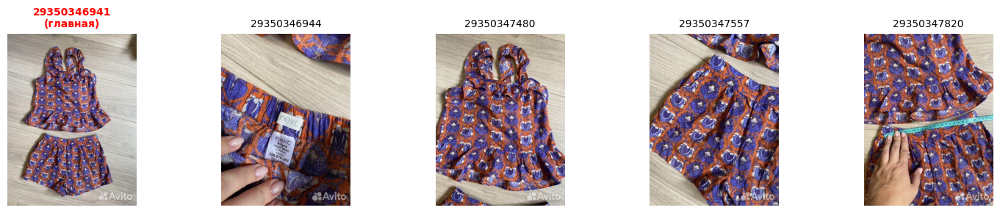


--- Объявление 26 (index=441) ---
Title: Ботинки зимние
Description: Ботинки зимние ( идеально подойдут и на осень)для мальчика .
Стильные, классные.
по стельке 13,5 см, но т.к внутри достаточно плотный утеплитель подойдут на 11-12 см.
Состояние Новых.
Category: (М) Обувь
Attrs: {'Предмет одежды': 'Обувь', 'Вид одежды': 'Для мальчиков', 'Вид объявления': 'Продаю своё', 'Цвет': 'Коричневый', 'Размер': '19,5 (12 см)', 'Бренд одежды': 'Без бренда', 'Вид обуви': 'Ботинки и туфли', 'Тип обуви': 'Ботинки'}


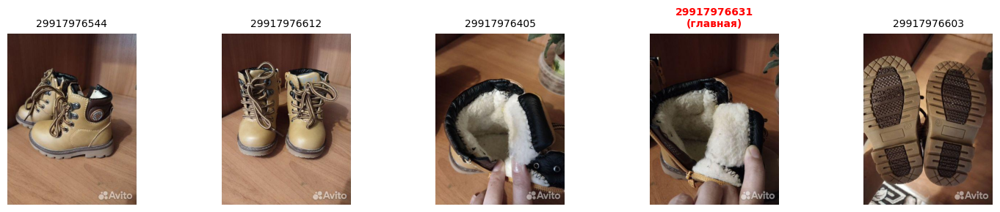


--- Объявление 27 (index=20919) ---
Title: Продаю джинсы на мальчика
Description: Продаю джинсы на мальчика, цвет черный, рост 152-158, фасон "бананы". Немного б/у. В хорошем состоянии. Самовывоз.
Category: (М) Брюки
Attrs: {'Предмет одежды': 'Брюки', 'Вид одежды': 'Джинсы', 'Вид объявления': 'Продаю своё', 'Цвет': 'Чёрный', 'Размер. Одежда': '158 см (13 лет)', 'Бренд одежды': 'Без бренда', 'Тип предмета одежды': 'Низ', 'Как часто надевали?': 'Несколько раз'}


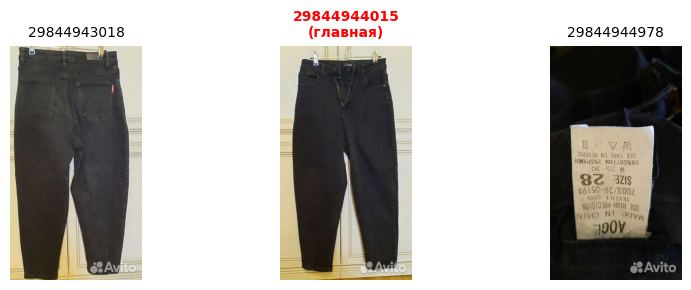


--- Объявление 28 (index=18121) ---
Title: Брюки на мальчика 152-158
Description: Брюки на мальчика размер 31. Цвет темно синий. носили в качестве формы в школе.  Без дыр и потёртостей, в хорошем состоянии. Длина изделия 100 см
Category: (М) Брюки
Attrs: {'Предмет одежды': 'Брюки', 'Вид одежды': 'Брюки', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '158 см (13 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Низ', 'Что сохранилось?': 'Ярлыки', 'Как часто надевали?': 'Несколько раз'}


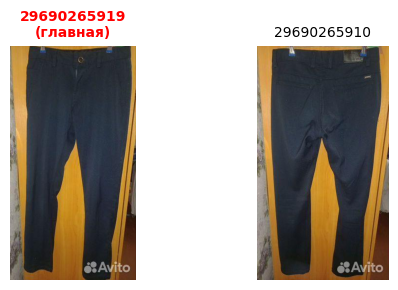


--- Объявление 29 (index=3102) ---
Title: Кроссовки для девочки Antilopa, 29 размер
Description: Кроссовки для девочки, бренд Antilopa, размер 29

👟 Состояние хорошее, носили в сад на физкультуру. Пару раз носили на улицу.
👟Липучки целые, стельки с супинатором не стёртые
👟 Удобные, лёгкие
Category: (Ж) Обувь
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Обувь', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Розовый', 'Размер': '29 (18,5 см)', 'Бренд одежды': 'Antilopa', 'Вид обуви': 'Кроссовки и кеды', 'Тип обуви': 'Кроссовки'}


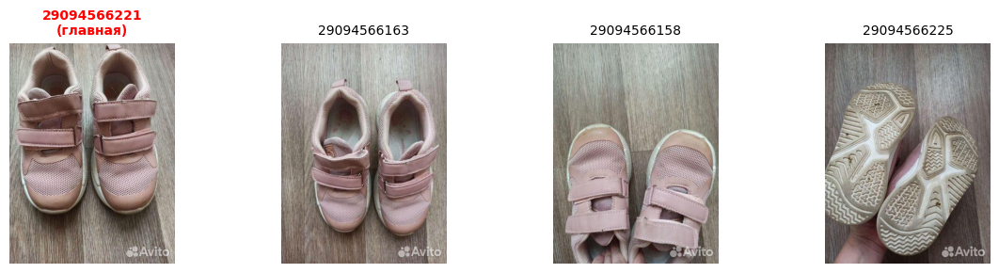


--- Объявление 30 (index=1157) ---
Title: Ботинки для девочки
Description: Продам ботинки на девочку ,размер 24,очень легкие и мягкие,носили и летом на холодную погоду и в теплую осень.Впереди шнурки,сбоку замок все в исправности.Небольшие дефекты видно на фото.
Category: (Ж) Обувь
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Обувь', 'Вид объявления': 'Продаю своё', 'Цвет': 'Бежевый', 'Размер': '24 (15 см)', 'Бренд одежды': 'Без бренда', 'Вид обуви': 'Ботинки и полуботинки', 'Тип обуви': 'Ботинки', 'Как часто надевали?': 'Регулярно'}


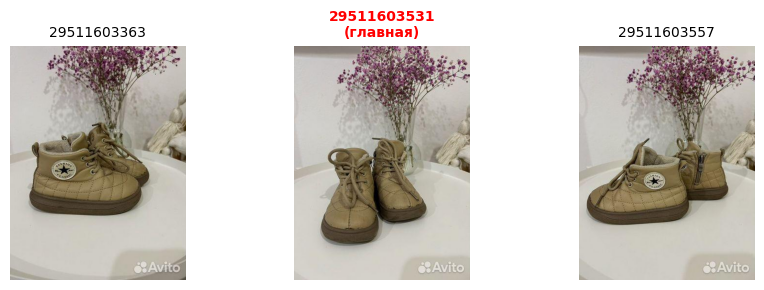


--- Объявление 31 (index=25842) ---
Title: Бубашка белая 122
Description: Блузка классического рубашечного покроя, с отстрочкой на груди. На рост 122см. Состояние хорошее, носилась только на праздники.
Отправлю доставкой, находится на Блюхера, 39
Category: (Ж) Блузки и рубашки
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Блузки и рубашки', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Белый', 'Размер. Одежда': '122 см (7 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх'}


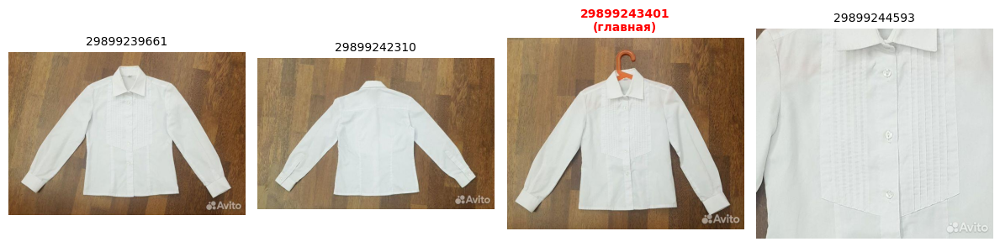


--- Объявление 32 (index=24619) ---
Title: Толстовка 128-130
Description: Толстовка с капюшоном на замке, надели пару раз, мала немного стала) ,классная, удобная, теплая и уютная.
Category: (М) Свитеры и толстовки
Attrs: {'Предмет одежды': 'Свитеры и толстовки', 'Вид одежды': 'Толстовки', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '128 см (8 лет)', 'Бренд одежды': 'Без бренда', 'Тип предмета одежды': 'Верх', 'Как часто надевали?': 'Несколько раз'}


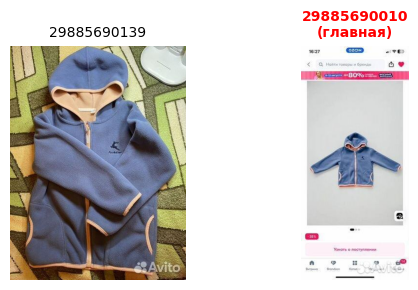


--- Объявление 33 (index=14804) ---
Title: Жакет школьный синий
Description: Жакет школьный, цвет темно-синий, размер не указан, на девочку ростом примерно 146-152 см, состояние отличное.
Category: (Ж) Пиджаки и костюмы
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Пиджаки и костюмы', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '152 см (12 лет)', 'Бренд одежды': 'Sabotage', 'Тип предмета одежды': 'Верх, Низ', 'Тип одежды': 'Школьная форма', 'Как часто надевали?': 'Несколько раз'}


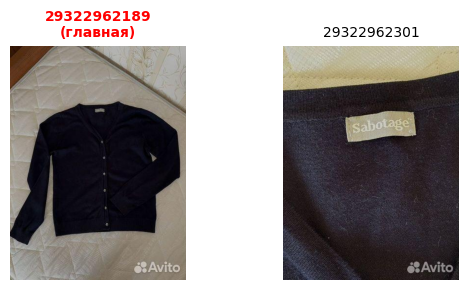


--- Объявление 34 (index=12596) ---
Title: Платье муслин 134
Description: Размер скорее до 128, дочка при росте 133 уже влазит со скрипом,хотя не полная. Идеальное состояние. Брала с али. После 1 ребенка
Category: (Ж) Платья и юбки
Attrs: {'Вид одежды': 'Платья', 'Предмет одежды': 'Платья и юбки', 'Вид объявления': 'Продаю своё', 'Размер. Одежда': '134 см (9 лет)', 'Бренд одежды': 'Без бренда', 'Тип предмета одежды': 'Верх, Низ'}


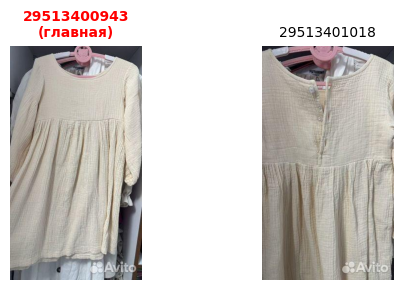


--- Объявление 35 (index=28193) ---
Title: Блузка школьная 140
Description: Блузка школьная Chessford, размер 140. 

Встреча в п.Ватутинки или в будние дни м.Коньково у ТЦ Тропа, могу подойти к турникетам метро Коньково.
Category: (Ж) Блузки и рубашки
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Блузки и рубашки', 'Вид объявления': 'Продаю своё', 'Цвет': 'Белый', 'Размер. Одежда': '140 см (10 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх', 'Как часто надевали?': 'Регулярно'}


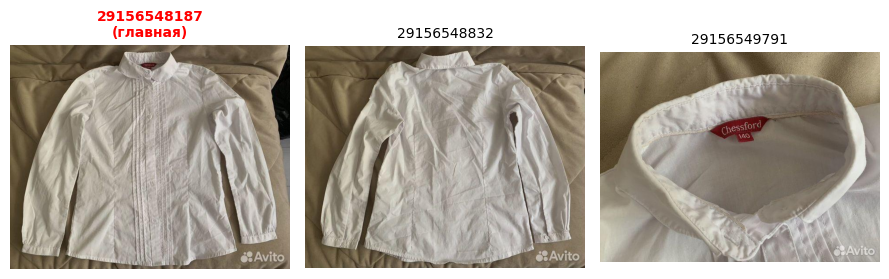


--- Объявление 36 (index=9072) ---
Title: Helly hansen дождевик 98+6
Description: Продам детский костюм дождевик Helly Hansen. На рост 98-104. Он как Reima +6 см
Дождевик без бирок, но совершенно новый. Я сняла бирки, чтобы ребенок примерил (с бирками отказался), но лето оказалось без дождей, он так и провисел на вешалке
Category: (М) Верхняя одежда
Attrs: {'Предмет одежды': 'Верхняя одежда', 'Вид одежды': 'Пальто и плащи', 'Вид объявления': 'Продаю своё', 'Цвет': 'Жёлтый', 'Размер. Одежда': '104 см (4 года)', 'Бренд одежды': 'Helly Hansen', 'Тип предмета одежды': 'Верх', 'Тип одежды': 'Дождевик', 'Как часто надевали?': 'Один раз'}


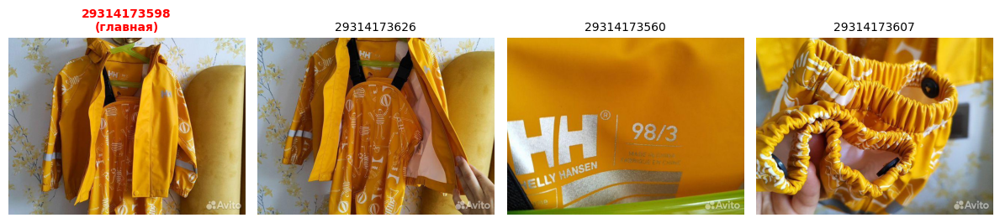


--- Объявление 37 (index=8904) ---
Title: Безрукавка на мальчика 116, хорошее состояние
Description: Безрукавка для мальчика рост  116,состояние хорошее! Молния рабочая,но, отломилась фитюлька у бегунка! Без него норм застегается.
Category: (М) Верхняя одежда
Attrs: {'Предмет одежды': 'Верхняя одежда', 'Вид одежды': 'Жилеты', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '116 см (6 лет)', 'Бренд одежды': 'Без бренда', 'Сезон': 'Демисезон', 'Утеплитель': 'С утеплителем', 'Особенности': 'Водонепроницаемость, Капюшон', 'Тип предмета одежды': 'Верх'}


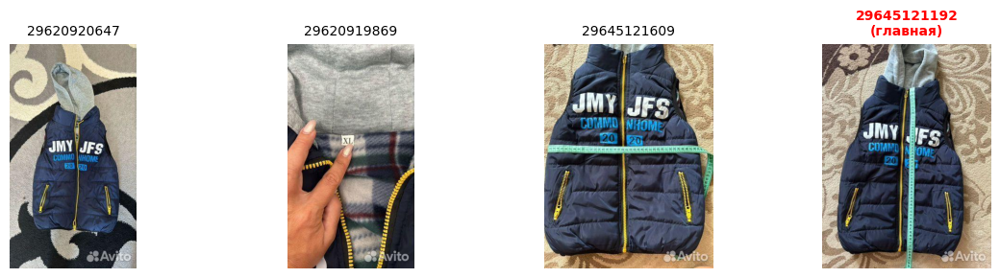


--- Объявление 38 (index=32534) ---
Title: Лонгслив C&A Minecraft 158 - 164 см
Description: яркий цвет, интересный рисунок
без дефектов, отличное состояние, рисунок без потертостей
длина по спинке 60 см,  полуобхват груди 46 см
Category: (М) Футболки и майки
Attrs: {'Предмет одежды': 'Футболки и майки', 'Вид одежды': 'Для мальчиков', 'Вид объявления': 'Продаю своё', 'Размер. Одежда': '158 см (13 лет)', 'Бренд одежды': 'Minecraft', 'Тип предмета одежды': 'Верх', 'Тип одежды': 'Лонгслив'}


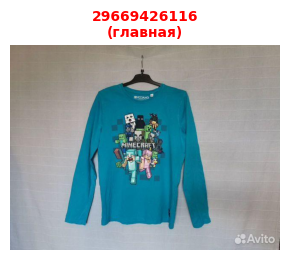


--- Объявление 39 (index=1043) ---
Title: Кроссовки детские 34 размер
Description: Кроссовки на физкультуру брали, ходили только в спортзале покупали в конце года поэтому носили мало. Очень удобные кроссовки. Брали в спортмастере.
Category: (Ж) Обувь
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Обувь', 'Вид объявления': 'Продаю своё', 'Цвет': 'Чёрный', 'Размер': '34 (21,5 см)', 'Бренд одежды': 'Другой', 'Вид обуви': 'Кроссовки и кеды', 'Тип обуви': 'Кроссовки', 'Как часто надевали?': 'Несколько раз'}


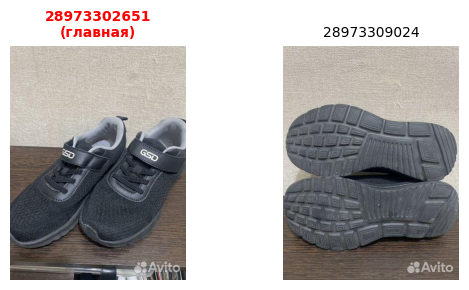


--- Объявление 40 (index=12005) ---
Title: Сарафан школьный 146
Description: Лёгкий сарафан прямого кроя с накладными кармашками на девочку ростом 140-146 синего цвета. Молния сбоку. Состояние отличное.
Category: (Ж) Платья и юбки
Attrs: {'Вид одежды': 'Платья', 'Предмет одежды': 'Платья и юбки', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '146 см (11 лет)', 'Бренд одежды': 'Без бренда', 'Тип предмета одежды': 'Верх, Низ'}


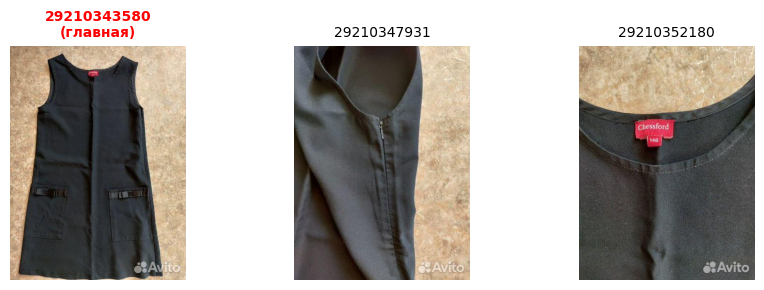


--- Объявление 41 (index=1303) ---
Title: Туфли школьные
Description: Школьные туфли фирмы Kenka, размер 36,по стельке 23 см.
Присутствуют следы носки,но не бросаются в глаза. Все недочёты на фото
Category: (Ж) Обувь
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Обувь', 'Вид объявления': 'Продаю своё', 'Цвет': 'Чёрный', 'Размер': '36 (23 см)', 'Бренд одежды': 'Другой', 'Вид обуви': 'Туфли и босоножки', 'Тип обуви': 'Туфли', 'Как часто надевали?': 'Регулярно', 'Дефекты основная часть': 'Следы носки, Мелкие потёртости, Значительные потёртости'}


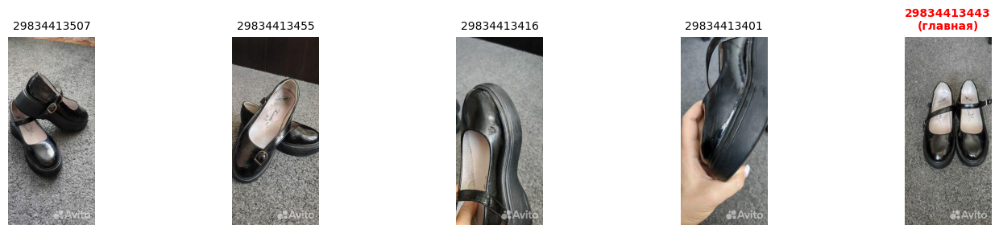


--- Объявление 42 (index=17598) ---
Title: Костюм спортивный для мальчика
Description: Спортивный костюм, можно не для спорта! Утепленный!

Несколько раз был в носке, аккуратно, без изъянов и дефектов!

На худенького мальчика!

140-146 рост
Category: (М) Пиджаки и костюмы
Attrs: {'Предмет одежды': 'Пиджаки и костюмы', 'Вид одежды': 'Костюмы', 'Вид объявления': 'Продаю своё', 'Цвет': 'Серый', 'Размер. Одежда': '146 см (11 лет)', 'Бренд одежды': 'Без бренда', 'Тип предмета одежды': 'Верх, Низ', 'Тип одежды': 'Спортивный костюм', 'Что сохранилось?': 'Ярлыки', 'Как часто надевали?': 'Несколько раз'}


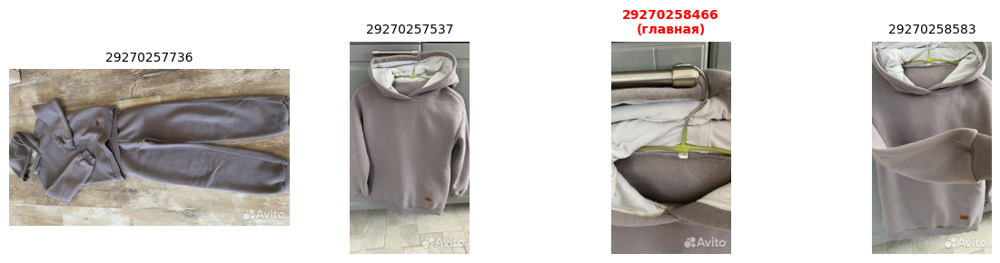


--- Объявление 43 (index=16177) ---
Title: Летний комплект на девочку 128
Description: Комплект из футболки и велошорт из мягкого хлопкового джерси. Футболка с принтом и спущенными плечами. Шорты с эластичным поясом.

H&M

🤍🤍🤍🤍🤍🤍🤍🤍🤍🤍

Размер 

128( 7-8 лет )
Category: (Ж) Пиджаки и костюмы
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Пиджаки и костюмы', 'Состояние': 'Новый', 'Вид объявления': 'Продаю своё', 'Цвет': 'Розовый', 'Размер. Одежда': '128 см (8 лет)', 'Бренд одежды': 'H&M', 'Тип предмета одежды': 'Верх, Низ', 'Тип одежды': 'Костюм'}


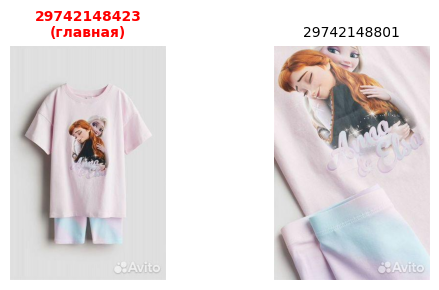


--- Объявление 44 (index=14943) ---
Title: Зимний костюм для девочки
Description: Продам зимний костюм на девочку , размеры указаны на фото, одевали несколько раз в Шерегеш , покупался в спортмастере
Category: (Ж) Пиджаки и костюмы
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Пиджаки и костюмы', 'Вид объявления': 'Продаю своё', 'Размер. Одежда': '152 см (12 лет)', 'Бренд одежды': 'Glissade', 'Тип предмета одежды': 'Верх, Низ', 'Тип одежды': 'Спортивный костюм', 'Как часто надевали?': 'Несколько раз'}


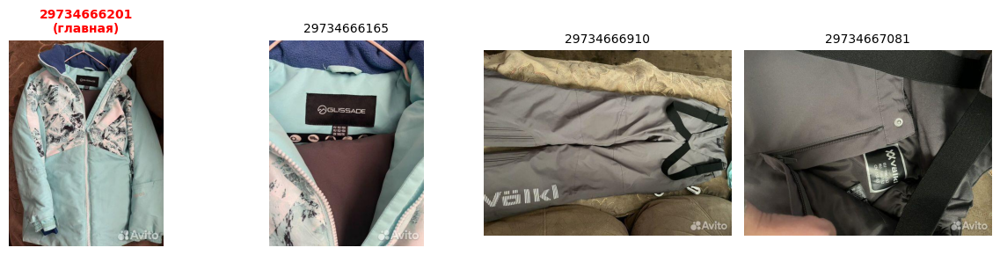


--- Объявление 45 (index=18393) ---
Title: Брюки школьные
Description: Продаю детские школьные брюки размер 158, подойдут на мальчика стройного телосложения. Состояние отличное, носили всего несколько раз, были как запасные.
Category: (М) Брюки
Attrs: {'Предмет одежды': 'Брюки', 'Вид одежды': 'Брюки', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '158 см (13 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Низ', 'Как часто надевали?': 'Несколько раз'}


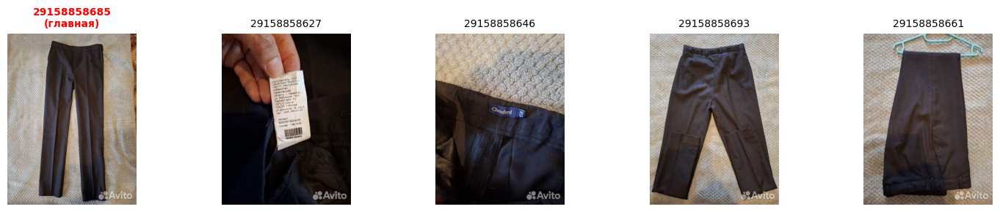


--- Объявление 46 (index=32542) ---
Title: Футболки для двойни
Description: Новые футболки, немного отличается рисунок, подойдет для двойни. В идеальном состоянии, надевали один раз, подарили, а размер не подошел, мало мерят немного
Category: (Ж) Футболки и топы
Attrs: {'Вид одежды': 'Футболки', 'Предмет одежды': 'Футболки и топы', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Розовый', 'Размер. Одежда': '116 см (6 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх'}


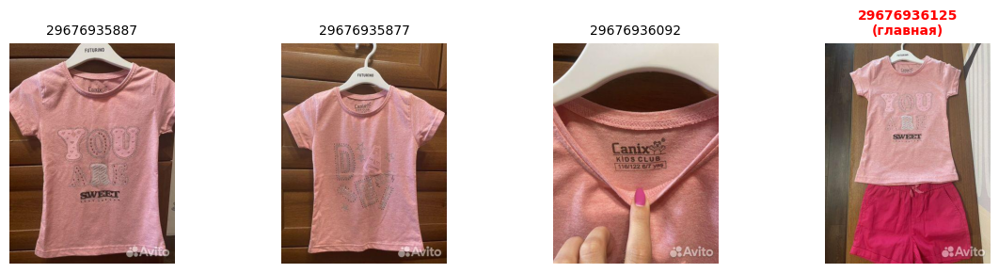


--- Объявление 47 (index=12802) ---
Title: Платье для девочки от 110 до 134
Description: Хлопок 100%. Новое. На рост от 110 до 134. Вышевка по подолу. Очень нарядное. На любую фигуру. Без пятен и затяжек!
Category: (Ж) Платья и юбки
Attrs: {'Вид одежды': 'Платья', 'Предмет одежды': 'Платья и юбки', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Белый', 'Размер. Одежда': '110 см (5 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх, Низ', 'Что сохранилось?': 'Ярлыки', 'Как часто надевали?': 'Один раз'}


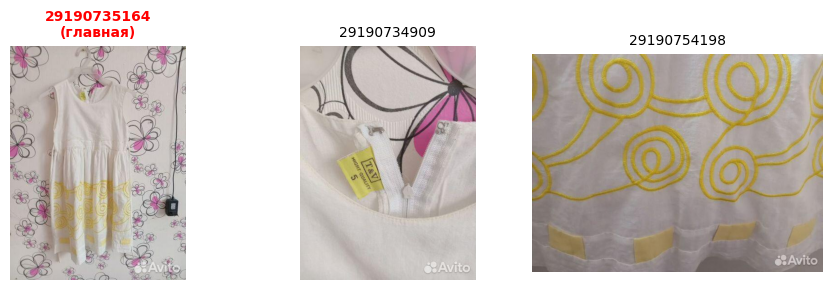


--- Объявление 48 (index=23668) ---
Title: Кофта кашемир
Description: Детская водолазка французского бренда I Pinco pallino, новая. Очень мягкая и приятная к телу. В составе кашемир.
Category: (Ж) Свитеры и толстовки
Attrs: {'Вид одежды': 'Кофты', 'Предмет одежды': 'Свитеры и толстовки', 'Вид объявления': 'Продаю своё', 'Цвет': 'Серый', 'Размер. Одежда': '116 см (6 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх', 'Тип одежды': 'Водолазка', 'Что сохранилось?': 'Бирки'}


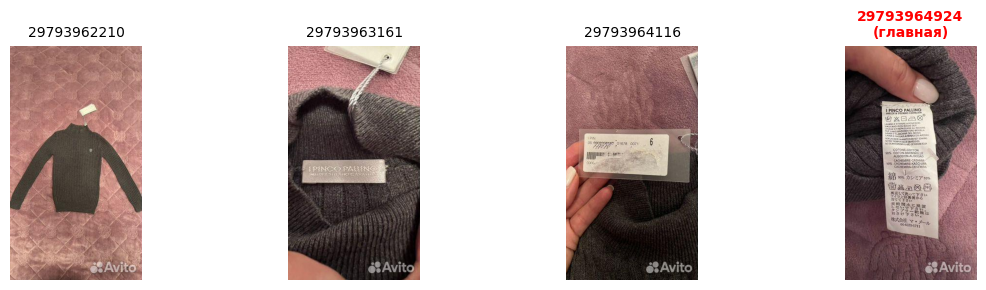


--- Объявление 49 (index=29828) ---
Title: Рубашка
Description: Рубашка для мальчика  тонкий хлопок, расцветка под джинс. В отлном состоянии. Рукав длинный, но можно заказать и зафиксировать на пуговицу. Рост 146-152си
Category: (М) Рубашки
Attrs: {'Предмет одежды': 'Рубашки', 'Вид одежды': 'Для мальчиков', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '164 см (14 лет)', 'Бренд одежды': 'Musti', 'Тип предмета одежды': 'Верх', 'Как часто надевали?': 'Несколько раз'}


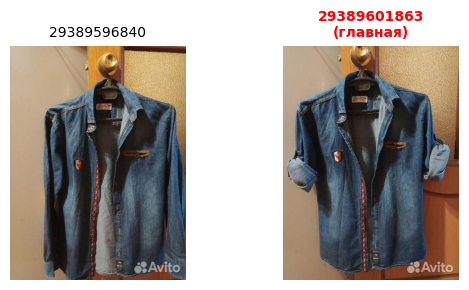


--- Объявление 50 (index=33049) ---
Title: Рубашка школьная р152
Description: Рубашка школьная белая с рисунком, о 152
Хорошего качества, для школу очень комфортно.
Состояние хорошее
Category: (М) Рубашки
Attrs: {'Предмет одежды': 'Рубашки', 'Вид одежды': 'Для мальчиков', 'Вид объявления': 'Продаю своё', 'Цвет': 'Белый', 'Размер. Одежда': '152 см (12 лет)', 'Бренд одежды': 'Button Blue', 'Тип предмета одежды': 'Верх', 'Как часто надевали?': 'Несколько раз'}


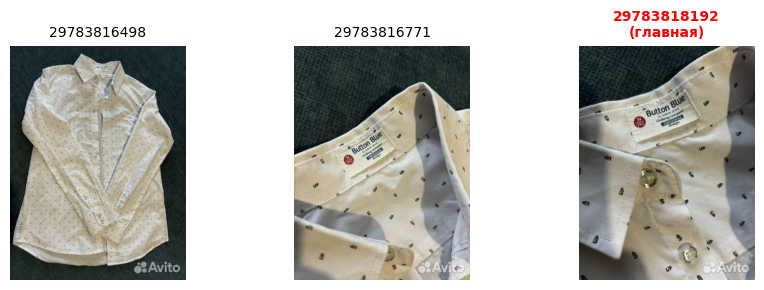


--- Объявление 51 (index=17398) ---
Title: Мужской костюм на мальчика р.164
Description: Костюм мужской на мальчика подростка. Относили всего пол года, стал мал. В отличном состоянии. Подойдет для худенького мальчика. Брали в 2 раза дороже
Category: (М) Пиджаки и костюмы
Attrs: {'Предмет одежды': 'Пиджаки и костюмы', 'Вид одежды': 'Костюмы', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '164 см (14 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх, Низ', 'Тип одежды': 'Школьная форма'}


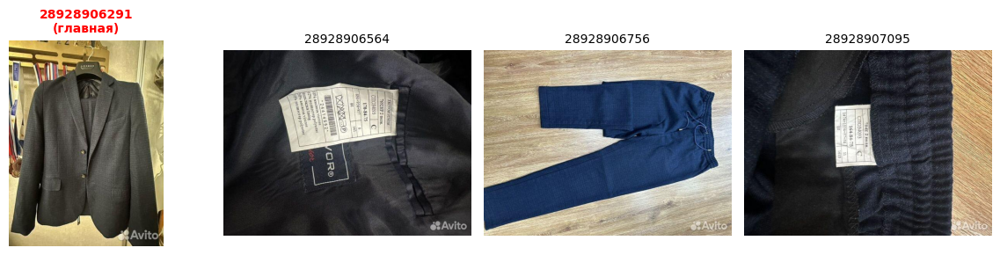


--- Объявление 52 (index=18307) ---
Title: Штаны джинсы брюки подростковые
Description: Продам на рост 164-168 см
Утепленные прямые черные джинсы 
Джинсы темно-синие
Брюки зимние для долгих прогулок и катаний
Category: (М) Брюки
Attrs: {'Предмет одежды': 'Брюки', 'Вид одежды': 'Джинсы', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '158 см (13 лет)', 'Бренд одежды': 'Без бренда', 'Тип предмета одежды': 'Низ', 'Что сохранилось?': 'Бирки, Ярлыки', 'Как часто надевали?': 'Регулярно', 'Дефекты основная часть': 'Мелкие потёртости'}


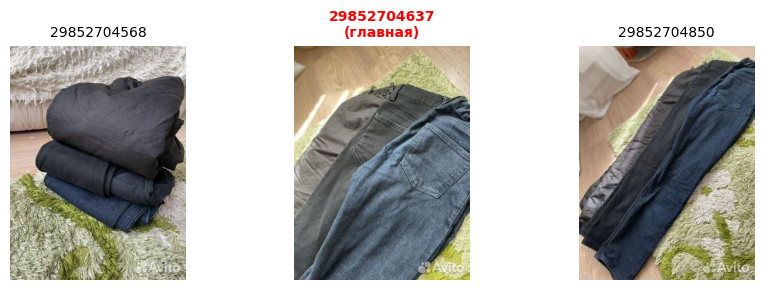


--- Объявление 53 (index=70) ---
Title: Кроссовки детские
Description: Продам милейшие кроссовки на мальчика. 
Лёгкие и стильные. 
Новые
почтой не отправляю‼️ только Яндекс и 5 post
Category: (М) Обувь
Attrs: {'Предмет одежды': 'Обувь', 'Вид одежды': 'Для мальчиков', 'Состояние': 'Новый', 'Вид объявления': 'Продаю своё', 'Цвет': 'Коричневый', 'Размер': '25 (15,5 см)', 'Бренд одежды': 'Без бренда', 'Вид обуви': 'Кроссовки и кеды', 'Тип обуви': 'Кроссовки'}


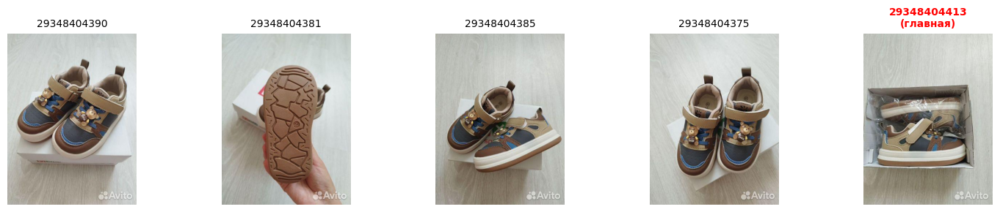


--- Объявление 54 (index=36164) ---
Title: Платье рубашка
Description: Джинсовое платье-рубашка для маленькой модницы. Мягкая джинса. Можно надевать как платье, с легинсами, как кардиган поверх другой одежды. Состояние отличное. Никаких нюансов нет. Ширина- 34 см. Длина рукава 36 см. 
 Могу отправить яндексом.
Category: (Ж) Блузки и рубашки
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Блузки и рубашки', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '104 см (4 года)', 'Бренд одежды': 'Next', 'Тип предмета одежды': 'Верх', 'Как часто надевали?': 'Несколько раз'}


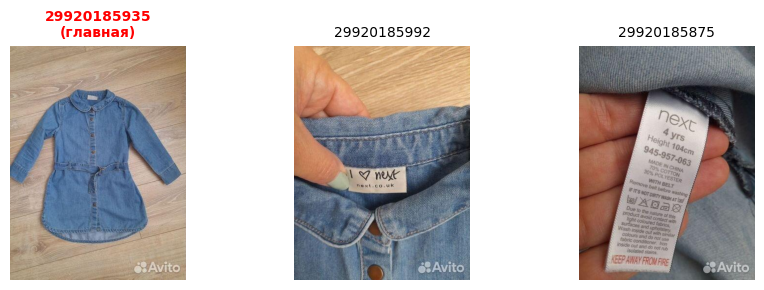


--- Объявление 55 (index=12234) ---
Title: Костьм летний для девочки
Description: Костюм для девочек,костюм домашний для девочек,костюм спортивный для девочек,праздничный костюм для девочек,костюм для улицы
Размеры с 4 лет до 12 лет
Будь всегда модной!
Category: (Ж) Платья и юбки
Attrs: {'Вид одежды': 'Платья', 'Предмет одежды': 'Платья и юбки', 'Состояние': 'Новый', 'Вид объявления': 'Продаю своё', 'Цвет': 'Разноцветный', 'Размер. Одежда': '116 см (6 лет)', 'Бренд одежды': 'Reima', 'Тип предмета одежды': 'Верх, Низ'}


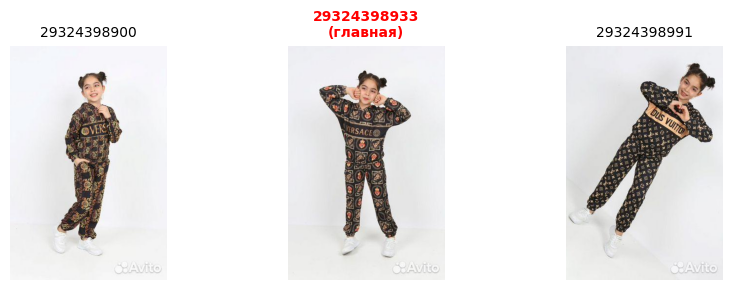


--- Объявление 56 (index=3388) ---
Title: Сандалии детские для девочек
Description: Сандали в нормальном состоянии, размер с11, липучки липнут, сносу нет у этого бренда. Удобные и комфортные
Category: (Ж) Обувь
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Обувь', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Голубой', 'Размер': '28 (17,5 см)', 'Бренд одежды': 'Crocs', 'Вид обуви': 'Сандалии и сланцы'}


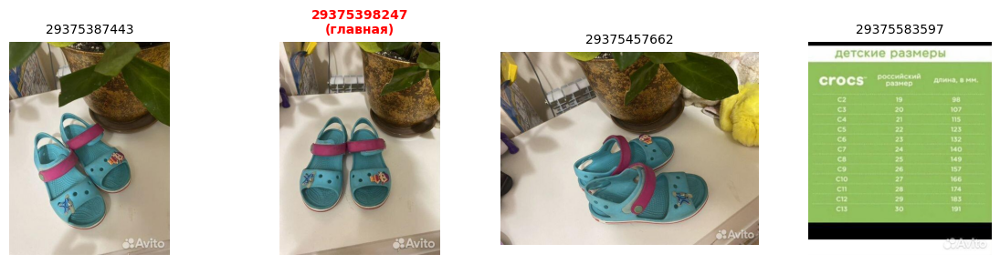


--- Объявление 57 (index=17735) ---
Title: Джинсы
Description: Голубые новые цена 650р. рост 140 PlayToday Молния+пуговка
Черные одеты 1 раз цена 500р. рост 152 резинка
Серые в подарок при покупке комплектом.Резинка. рост 140
Category: (Ж) Брюки
Attrs: {'Вид одежды': 'Джинсы', 'Предмет одежды': 'Брюки', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Размер. Одежда': '140 см (10 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Низ'}


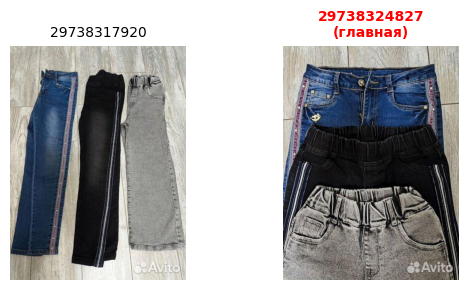


--- Объявление 58 (index=34111) ---
Title: Блуза
Description: Блузка трикотажная
светло-розовый Nota Bene.
Вид застежки пуговица и резинка Рукава длинные
Материал кулирка с лайкрой
Производство РОССИЯ
Сезон круглогодичный
Состав 92% хлопок; 8% лайкра
Уход за вещами машинная стирка при t не более 40C
Фактура материала трикотажный
Форма рукава втачной
Category: (Ж) Блузки и рубашки
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Блузки и рубашки', 'Вид объявления': 'Продаю своё', 'Цвет': 'Розовый', 'Размер. Одежда': '134 см (9 лет)', 'Бренд одежды': 'Без бренда', 'Тип предмета одежды': 'Верх'}


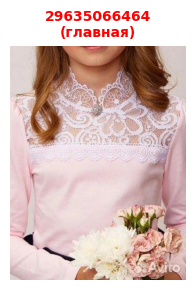


--- Объявление 59 (index=20042) ---
Title: Джинсы утепленные
Description: Джинсы на флисе,для прохладного времени года. Теплые и удобные. Пояс на резинке,регулируется . Носили в садик.
Category: (М) Брюки
Attrs: {'Предмет одежды': 'Брюки', 'Вид одежды': 'Джинсы', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '104 см (4 года)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Низ', 'Что сохранилось?': 'Ярлыки', 'Как часто надевали?': 'Несколько раз'}


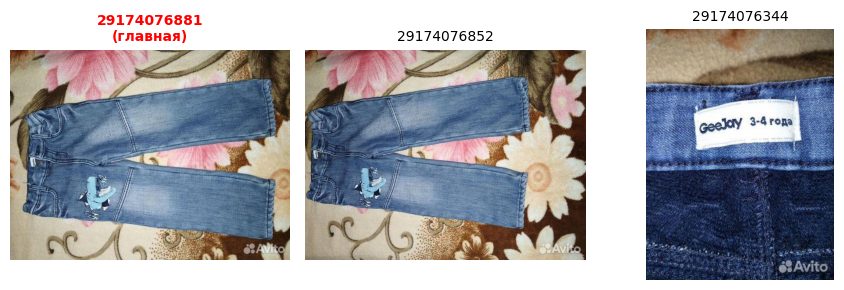


--- Объявление 60 (index=10090) ---
Title: Куртка зимняя Reima 122
Description: Зимняя куртка Reima, размер 122 +6 см. Наполнитель 180 г. до -25 С. Имеются потертости на рукавах (фото прилагается).
Category: (Ж) Верхняя одежда
Attrs: {'Вид одежды': 'Куртки и пуховики', 'Предмет одежды': 'Верхняя одежда', 'Вид объявления': 'Продаю своё', 'Цвет': 'Розовый', 'Размер. Одежда': '122 см (7 лет)', 'Бренд одежды': 'Reima', 'Сезон': 'Зима', 'Утеплитель': 'С утеплителем', 'Особенности': 'Водонепроницаемость, Светоотражающие детали, Капюшон, Воротник', 'Тип предмета одежды': 'Верх', 'Тип одежды': 'Куртка', 'Дефекты основная часть': 'Мелкие потёртости'}


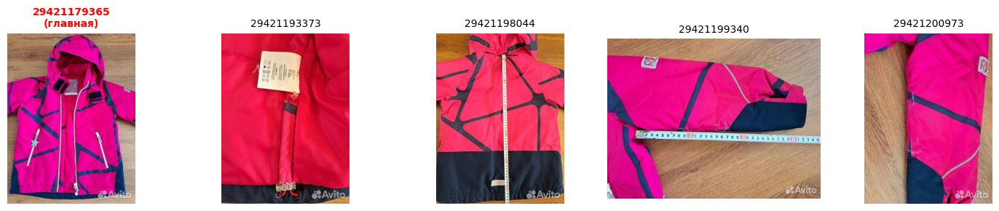


--- Объявление 61 (index=8499) ---
Title: Куртка демисезонная для девочки 92
Description: Продаю куртку для девочки фирмы Mayoral,  на погоду где то до -5 градусов. Большемерит на размер. Новая, срезали бирки и ни разу не надели, переросли. Длина рукава 33 см, длина куртки 46 см от плеча.
Category: (Ж) Верхняя одежда
Attrs: {'Вид одежды': 'Куртки и пуховики', 'Предмет одежды': 'Верхняя одежда', 'Состояние': 'Новый', 'Вид объявления': 'Продаю своё', 'Цвет': 'Бежевый', 'Размер. Одежда': '92 см (2 года)', 'Бренд одежды': 'Mayoral', 'Сезон': 'Зима', 'Утеплитель': 'С утеплителем', 'Особенности': 'Капюшон, Воротник', 'Тип предмета одежды': 'Верх'}


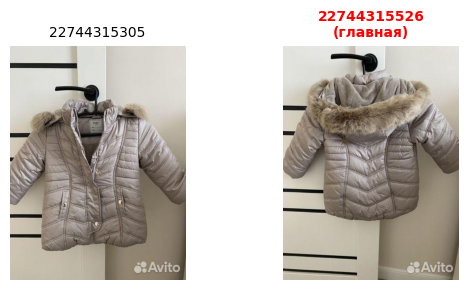


--- Объявление 62 (index=35741) ---
Title: Рубашка для девочки школьная
Description: Рубашка ( блузка) школьная для девочки. Белая. Смотрится шикарно. Одевали только на очень ответственные дни, такие как четвертные контрольные. Блузка приносила удачу и хорошие отметки.
Category: (Ж) Блузки и рубашки
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Блузки и рубашки', 'Вид объявления': 'Продаю своё', 'Цвет': 'Белый', 'Размер. Одежда': '152 см (12 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх', 'Как часто надевали?': 'Несколько раз'}


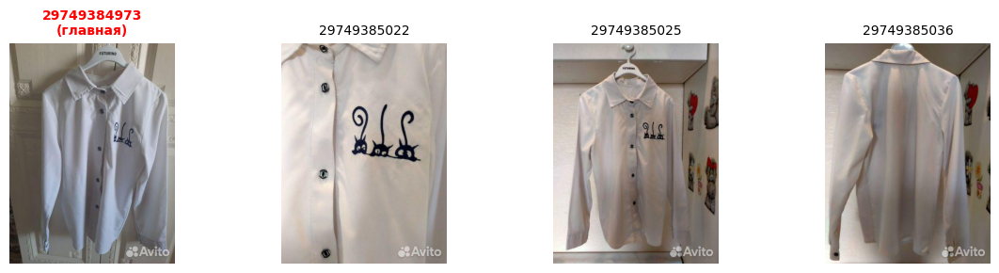


--- Объявление 63 (index=20222) ---
Title: Джинсы на подростка на 164 -170 рост
Description: Джинсы на подростка на рост 164-170, длина джинсов 100 см, ширина бедер 48 см, растягиваются, стрейдж. В хорошем состоянии, одевали несколько раз.
Category: (М) Брюки
Attrs: {'Предмет одежды': 'Брюки', 'Вид одежды': 'Джинсы', 'Вид объявления': 'Продаю своё', 'Цвет': 'Чёрный', 'Размер. Одежда': '164 см (14 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Низ', 'Как часто надевали?': 'Несколько раз'}


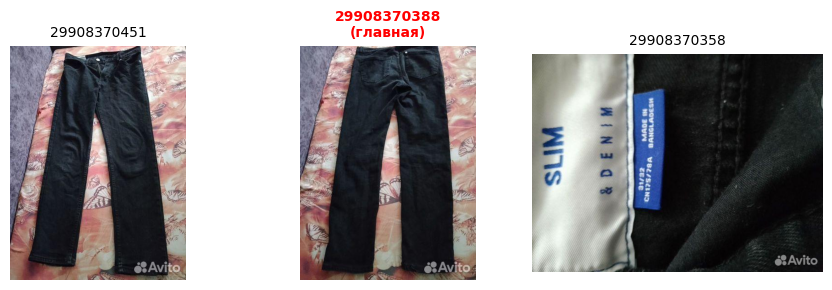


--- Объявление 64 (index=15601) ---
Title: Школьная форма для девочки
Description: Продаем очень красивую форму для первоклассницы)
Надевали пару раз-на 1 сентября и на фотосессию.
Подойдет на миниатюрную девочку.
Воротник на блузке снимается.
Category: (Ж) Пиджаки и костюмы
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Пиджаки и костюмы', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '122 см (7 лет)', 'Бренд одежды': 'Форма', 'Тип предмета одежды': 'Верх, Низ', 'Тип одежды': 'Школьная форма'}


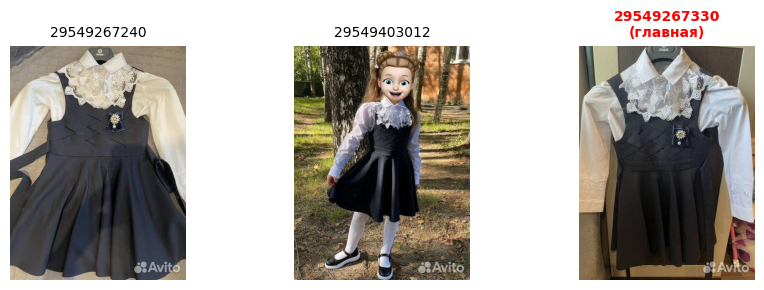


--- Объявление 65 (index=35517) ---
Title: Школьная форма для мальчика 122
Description: Продам школьную форму на мальчика темно-синего цвета: кардиган, брюки, 3 рубашки. Все в хорошем состоянии. Возможен торг.
Category: (М) Рубашки
Attrs: {'Предмет одежды': 'Рубашки', 'Вид одежды': 'Для мальчиков', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '122 см (7 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх'}


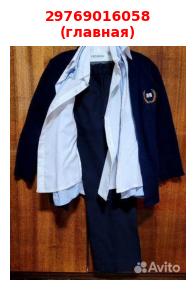


--- Объявление 66 (index=22895) ---
Title: Жилетка для мальчика 80
Description: Продам детскую жилетку на мальчика размер 80. Подойдет на осень и летний период. Носили не много, ребенок полный и быстро стало мало в обхвате) из дефектов на кармашке обломился бегунок 🤷🏼‍♀️ 
Стоимость 350₽ 
Бебигоу
Category: (М) Свитеры и толстовки
Attrs: {'Предмет одежды': 'Свитеры и толстовки', 'Вид одежды': 'Свитеры', 'Вид объявления': 'Продаю своё', 'Цвет': 'Жёлтый', 'Размер. Одежда': '80 см (12 мес.)', 'Бренд одежды': 'Babygo', 'Тип предмета одежды': 'Верх', 'Тип одежды': 'Жилетка', 'Как часто надевали?': 'Регулярно', 'Дефекты детали и фурнитура': 'Сломаная фурнитура'}


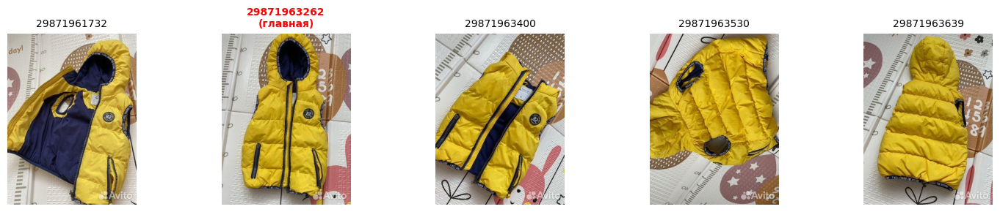


--- Объявление 67 (index=25822) ---
Title: Блузка детская h&m
Description: 12-13 лет на рост 158
Нежно-розовая блузка с подкладкой, одевала 1 раз, не подошел размер. Совершенно новая, дефектов и пятен нет, нитки не торчат, на ощупь очень мягкая

Состав: 100% полиэстер

торг доступен
Category: (Ж) Блузки и рубашки
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Блузки и рубашки', 'Состояние': 'Новый', 'Вид объявления': 'Продаю своё', 'Цвет': 'Розовый', 'Размер. Одежда': '158 см (13 лет)', 'Бренд одежды': 'H&M', 'Тип предмета одежды': 'Верх'}


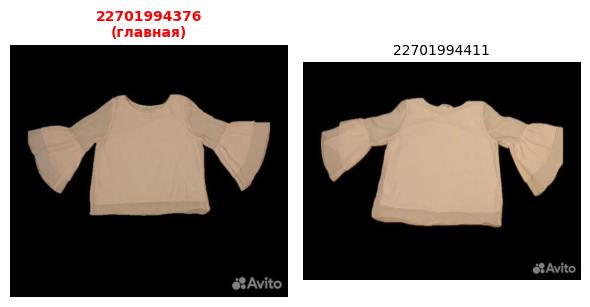


--- Объявление 68 (index=13687) ---
Title: Школьный сарафан M&S
Description: Сарафан для школы Marks&Spencer
Размер 140-72-77, подойдёт на рост от 134 см
Тёмно-серого цвета
Без застёжек и молний, удобно одевать и снимать
Category: (Ж) Платья и юбки
Attrs: {'Вид одежды': 'Платья', 'Предмет одежды': 'Платья и юбки', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Серый', 'Размер. Одежда': '134 см (9 лет)', 'Бренд одежды': 'Marks&Spencer', 'Тип предмета одежды': 'Верх, Низ'}


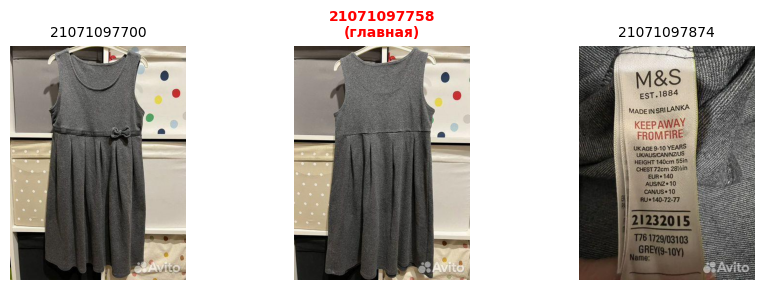


--- Объявление 69 (index=32842) ---
Title: Батник для мальчика рост 128
Description: Батник с длинными  рукавами . Перед и спинка серого цвета .На серой ткани  крупные буквы чёрного и белого цвета . Вырез под горло  и отделан чёрной бейкой.Рукав двухцветный  (верх цветной , низ чёрный ).Смотрится  очень красиво . После одного ребёнка .Замеры : длинна по спинке 48см.  ширина 39 см. длинна рукава 46,5 см.
Category: (М) Рубашки
Attrs: {'Предмет одежды': 'Рубашки', 'Вид одежды': 'Для мальчиков', 'Вид объявления': 'Продаю своё', 'Цвет': 'Чёрный', 'Размер. Одежда': '128 см (8 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх', 'Как часто надевали?': 'Несколько раз'}


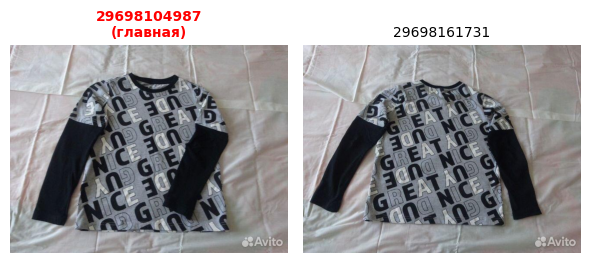


--- Объявление 70 (index=8140) ---
Title: Куртка детская 98
Description: Детская куртка светло-розового цвета 98 размер зимняя очень теплая.
Капюшон есть, манжеты, резинка на талии. 
Носили один сезон, один ребенок.
Category: (М) Верхняя одежда
Attrs: {'Предмет одежды': 'Верхняя одежда', 'Вид одежды': 'Куртки и пуховики', 'Вид объявления': 'Продаю своё', 'Цвет': 'Розовый', 'Размер. Одежда': '98 см (3 года)', 'Бренд одежды': 'Sinsay', 'Сезон': 'Зима', 'Утеплитель': 'С утеплителем', 'Особенности': 'Водонепроницаемость, Капюшон', 'Тип предмета одежды': 'Верх', 'Тип одежды': 'Куртка', 'Как часто надевали?': 'Несколько раз'}


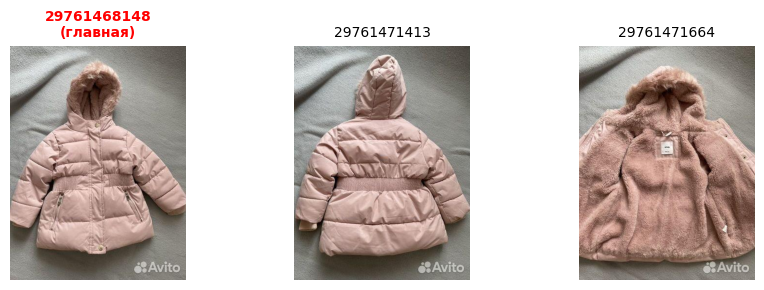


--- Объявление 71 (index=35710) ---
Title: Рубашка для мальчика Acoola 146
Description: Рубашка для мальчика, на рост 146, в хорошем состоянии, пятен нет, цвет вживую немного темнее, мелкий рисунок(клетка /полоска)
Category: (М) Рубашки
Attrs: {'Предмет одежды': 'Рубашки', 'Вид одежды': 'Для мальчиков', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '146 см (11 лет)', 'Бренд одежды': 'Acoola', 'Тип предмета одежды': 'Верх'}


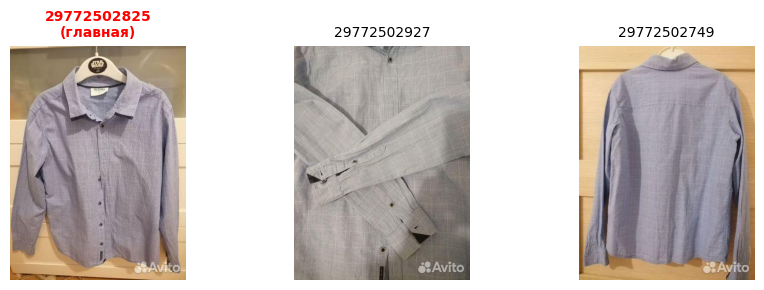


--- Объявление 72 (index=1796) ---
Title: Детские резиновые тапочки сабо
Description: Удобные, мягкие, гибкие, симпотичные тапочки. Материал EVA. Размер 14 см указано, но длина стопы тогда 13,5 см.
Носили только дома несколько раз (не угадала с размером).
Category: (Ж) Обувь
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Обувь', 'Вид объявления': 'Продаю своё', 'Цвет': 'Разноцветный', 'Размер': '22 (13,5 см)', 'Бренд одежды': 'Другой', 'Вид обуви': 'Домашняя обувь', 'Как часто надевали?': 'Несколько раз'}


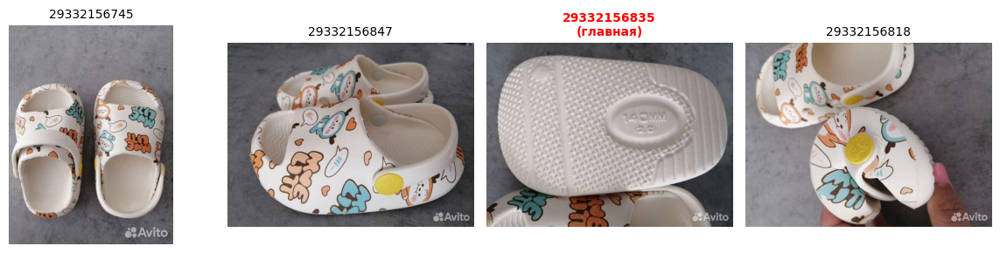


--- Объявление 73 (index=1786) ---
Title: Сабо тапки сланцы шлепки 34-35 и 37 размеры
Description: Сланцы ,тапочки для ванны, душа,бассейна, пляжа.Бегать по огороду идеальный вариант.
В оличном состоянии; на размер до 34,35(фиолетовые).держатель для пяточки,не слетят с ноги
36-37(синие)
за одну пару 300 руб
Category: (М) Обувь
Attrs: {'Предмет одежды': 'Обувь', 'Вид одежды': 'Для мальчиков', 'Состояние': 'Новый', 'Вид объявления': 'Продаю своё', 'Размер': '35 (22,5 см)', 'Бренд одежды': 'Другой', 'Вид обуви': 'Сандалии и сланцы'}


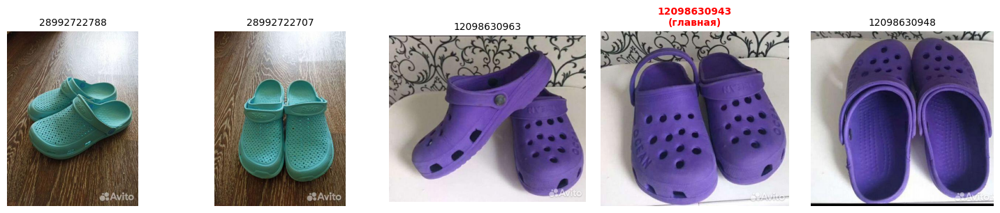


--- Объявление 74 (index=37322) ---
Title: Блузка школьная s размер
Description: Очень красивая, ажурная ,одевали 2-3 раза,состояние отличное, ажур растягивается,не прсвечивает, мерки в описании. Просто мы выросли!
Category: (Ж) Блузки и рубашки
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Блузки и рубашки', 'Вид объявления': 'Продаю своё', 'Цвет': 'Белый', 'Размер. Одежда': 'Без размера', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх', 'Что сохранилось?': 'Ярлыки', 'Как часто надевали?': 'Несколько раз'}


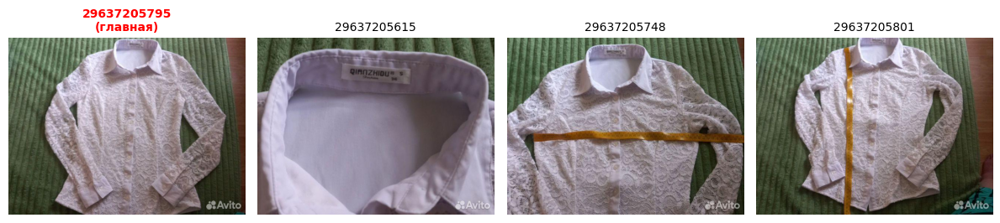


--- Объявление 75 (index=8487) ---
Title: Зимний комбинезон huppa 116
Description: Комбинезон в хорошем состоянии (немного пошерканы колени, почти не заметно. В остальном все идеально. Очень теплый, не продуваемый и не промокаемый.
Category: (М) Верхняя одежда
Attrs: {'Предмет одежды': 'Верхняя одежда', 'Вид одежды': 'Куртки и пуховики', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '116 см (6 лет)', 'Бренд одежды': 'Huppa', 'Сезон': 'Зима', 'Утеплитель': 'С утеплителем', 'Особенности': 'Водонепроницаемость, Светоотражающие детали, Капюшон, Воротник', 'Тип предмета одежды': 'Верх'}


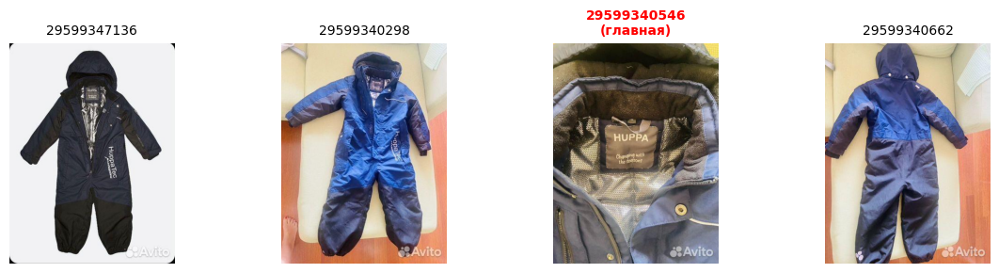


--- Объявление 76 (index=13398) ---
Title: Детский сарафан 92-98 новый
Description: Новый детский сарафан размер 92-98. очень хорошее качество. 
Сарафан для девочки из хлопка - идеальное летнее платье для вашей маленькой модницы. Оно выполнено из легкого и приятного на ощупь материала. Круглый вырез горловины, юбка со сборкой и открытая спинка придают особый шарм этой модели. Благодаря эластичной резинке на спинке сарафан идеально садится по фигуре, а крылышки-рукава добавляют непринужденности и легкости.
Category: (Ж) Платья и юбки
Attrs: {'Вид одежды': 'Платья', 'Предмет одежды': 'Платья и юбки', 'Состояние': 'Новый', 'Вид объявления': 'Продаю своё', 'Цвет': 'Чёрный', 'Размер. Одежда': '92 см (2 года)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх, Низ'}


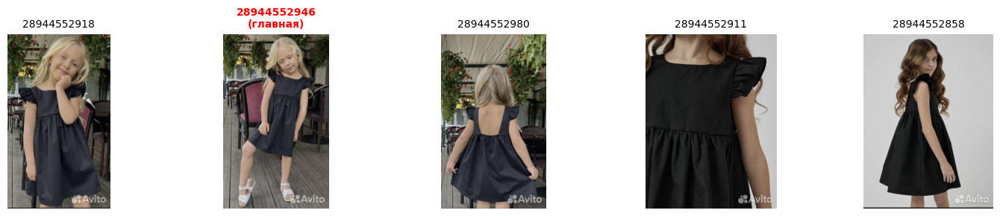


--- Объявление 77 (index=6526) ---
Title: Зимний комбинезон новый Arctix
Description: Амер.размер 2Т, новый, фирменный, теплый, технологичный. Привезены из США. Сидит красиво на детках. Унисекс.
Category: (М) Комбинезоны
Attrs: {'Предмет одежды': 'Комбинезоны', 'Вид одежды': 'Утеплённые комбинезоны', 'Состояние': 'Новый', 'Вид объявления': 'Продаю своё', 'Цвет': 'Чёрный', 'Размер. Одежда': '92 см (2 года)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх, Низ'}


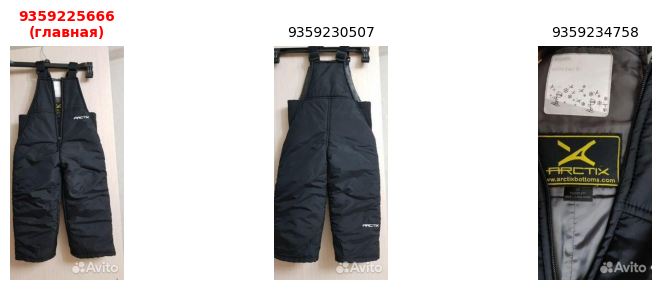


--- Объявление 78 (index=14731) ---
Title: Пиджак и брюки sky lake Ломоносов
Description: Пиджак Ломоносов рост 140 полнота 36, состояние хорошее, брюки тоже есть, замеры брюк по ширине на фото
Category: (М) Пиджаки и костюмы
Attrs: {'Предмет одежды': 'Пиджаки и костюмы', 'Вид одежды': 'Пиджаки', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '140 см (10 лет)', 'Бренд одежды': 'Sky Lake', 'Тип предмета одежды': 'Верх, Низ'}


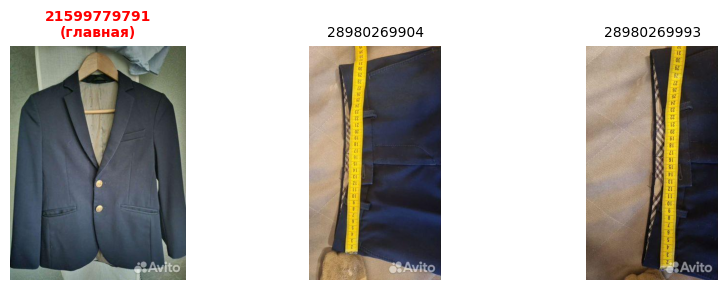


--- Объявление 79 (index=35192) ---
Title: Рубашка для мальчика
Description: Рубашка с коротким рукавом, хлопок, цвет голубой. Рост 146 см. Длина по спинке - 58 см. Фирма O'Stin. Цена - 150 р.
Category: (М) Рубашки
Attrs: {'Предмет одежды': 'Рубашки', 'Вид одежды': 'Для мальчиков', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Размер. Одежда': '146 см (11 лет)', 'Бренд одежды': "O'Stin", 'Тип предмета одежды': 'Верх'}


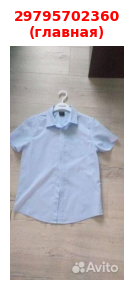


--- Объявление 80 (index=15953) ---
Title: Костюм для девочки (футболка и шорты)
Description: Новый костюм для девочки. На втором фото я оставила точно такой же для своей дочки, у вас будет абсолютно новый.
Для садика и летних прогулок, для пляжного отдыха и в отпуск.

Производство Турция! Не Китай! Все этикетки на турецком.

Качество прекрасное, испробовано на своем ребенке. Рисунок переживает стирки, глажки прямо по рисунку на двоечке, всё как новое после стирок. Швы не косятся, очень приятный материал.

Размеры от 2 до 5 лет.
Отправляю в другие регионы.
Category: (Ж) Пиджаки и костюмы
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Пиджаки и костюмы', 'Состояние': 'Новый', 'Вид объявления': 'Продаю своё', 'Цвет': 'Разноцветный', 'Размер. Одежда': '56 см (2 мес.)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх, Низ', 'Тип одежды': 'Спортивный костюм'}


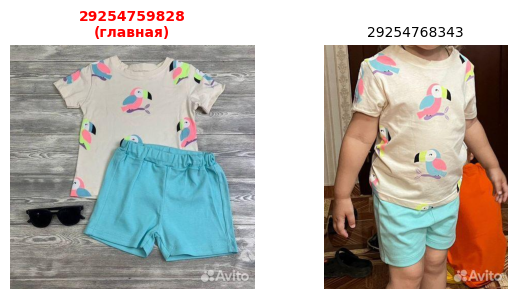


--- Объявление 81 (index=18481) ---
Title: Брюки школьные палаццо на девочку с жилетом
Description: Продам школьный костюм на девочку ростом от 152 до 160
Брюки палаццо и жилет 
В очень хорошем состоянии !
Category: (Ж) Брюки
Attrs: {'Вид одежды': 'Брюки', 'Предмет одежды': 'Брюки', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '152 см (12 лет)', 'Бренд одежды': 'Без бренда', 'Тип предмета одежды': 'Низ', 'Как часто надевали?': 'Несколько раз'}


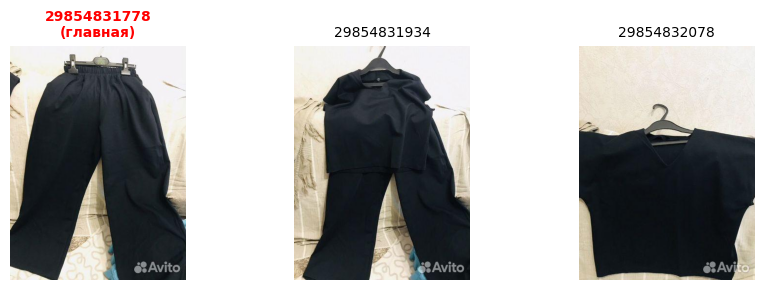


--- Объявление 82 (index=18469) ---
Title: Штаны осенние 128 и 132 размеры на подкладе
Description: Осенние брюки на мальчика на подкладе, без утеплителя  . 128 ( черные)р и 140(серые). Состояние отличное . Одевал 1-2 разв
Category: (М) Брюки
Attrs: {'Предмет одежды': 'Брюки', 'Вид одежды': 'Брюки', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Чёрный', 'Размер. Одежда': '128 см (8 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Низ'}


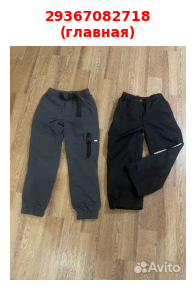


--- Объявление 83 (index=16162) ---
Title: Костюм для мальчика
Description: Классический костюм для мальчика, брюки и жилет, можно с рубашкой, все одевалось 1 раз на выпускной в сад. Состояние новое идеальное!  Размер 30(128-134)
Category: (М) Пиджаки и костюмы
Attrs: {'Предмет одежды': 'Пиджаки и костюмы', 'Вид одежды': 'Костюмы', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Чёрный', 'Размер. Одежда': '128 см (8 лет)', 'Бренд одежды': 'Без бренда', 'Тип предмета одежды': 'Верх, Низ', 'Тип одежды': 'Школьная форма', 'Что сохранилось?': 'Ярлыки', 'Как часто надевали?': 'Один раз'}


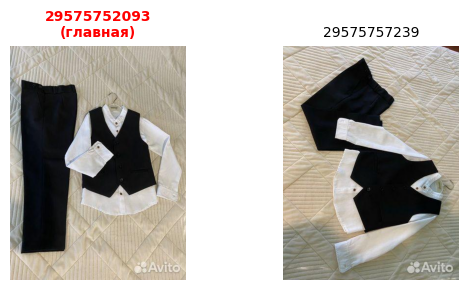


--- Объявление 84 (index=19912) ---
Title: Леггинсы H&M 92, 98, 98
Description: 3 пары утепленных лосин:

1) сиреневые 92 см;

2) бежевые 98 см;

3) с зайчиками 98 см.

+ вещи разные на рост 92 см
Category: (Ж) Брюки
Attrs: {'Вид одежды': 'Лосины и леггинсы', 'Предмет одежды': 'Брюки', 'Состояние': 'Новый', 'Вид объявления': 'Продаю своё', 'Цвет': 'Разноцветный', 'Размер. Одежда': '98 см (3 года)', 'Бренд одежды': 'H&M', 'Тип предмета одежды': 'Низ'}


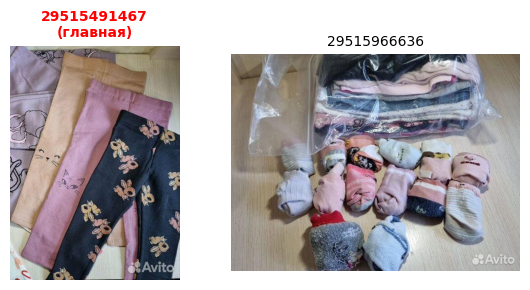


--- Объявление 85 (index=18801) ---
Title: Штаны для мальчика 86
Description: продам 3 брюк.
в хорошем состояние, носили весной один сезон.
размер 86
цена указана  за 3 штанов.

Вещи находятся в деревне. ЗАМЕРЫ И ОТПРАВКИ ТОЛЬКО НА ВЫХОДНЫХ ПО ДОГОВОРЕННОСТИ
Category: (М) Брюки
Attrs: {'Предмет одежды': 'Брюки', 'Вид одежды': 'Брюки', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Размер. Одежда': '86 см (18 мес.)', 'Бренд одежды': 'H&M', 'Тип предмета одежды': 'Низ'}


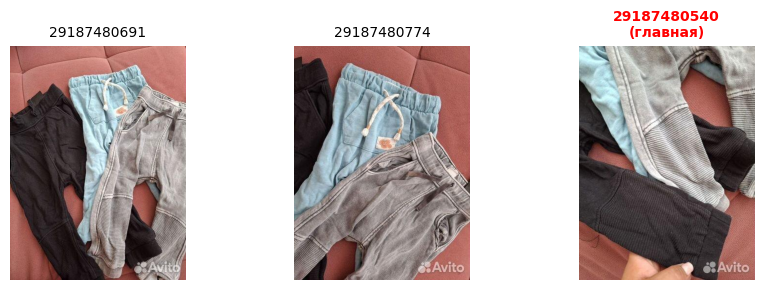


--- Объявление 86 (index=3104) ---
Title: Аквашузы детские
Description: Очень удобные тапочки для пляжа, ребенок бегал и по гальке и по песку 👍🏻
Состояние хорошее постираны

Пляжная обувь тапки для пляжа
Category: (Ж) Обувь
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Обувь', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Размер': '23 (14,5 см)', 'Бренд одежды': 'Без бренда', 'Вид обуви': 'Спортивная обувь'}


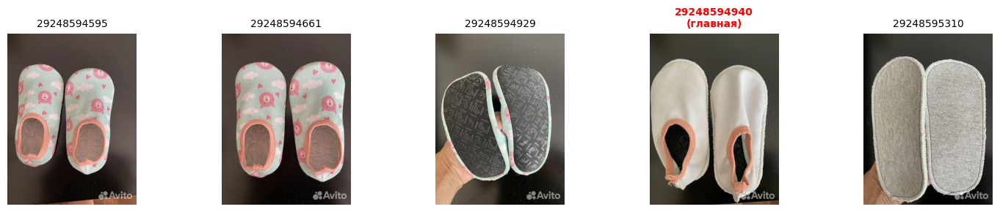


--- Объявление 87 (index=22169) ---
Title: Толстовка и брюки на 4/5 лет
Description: Толстовка на молнии и брюки розовые и зеленые вайкики, лосины найк, платье хлопок Все на 3/4 -4/5, желто розовая в подарок, 600 руб
Category: (М) Свитеры и толстовки
Attrs: {'Предмет одежды': 'Свитеры и толстовки', 'Вид одежды': 'Толстовки', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Размер. Одежда': '104 см (4 года)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх', 'Как часто надевали?': 'Несколько раз'}


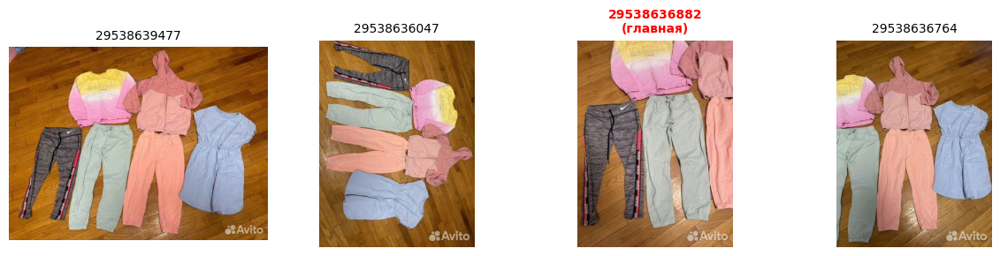


--- Объявление 88 (index=10836) ---
Title: Платье для девочки 128 см
Description: нарядное платье для девочки. надевали 1 раз на ДР. небольшое пятно, но за счёт расцветки не выделяется
Category: (Ж) Платья и юбки
Attrs: {'Вид одежды': 'Платья', 'Предмет одежды': 'Платья и юбки', 'Вид объявления': 'Продаю своё', 'Цвет': 'Разноцветный', 'Размер. Одежда': '128 см (8 лет)', 'Бренд одежды': 'Mayoral', 'Тип предмета одежды': 'Верх, Низ', 'Как часто надевали?': 'Один раз', 'Дефекты основная часть': 'Небольшие пятна'}


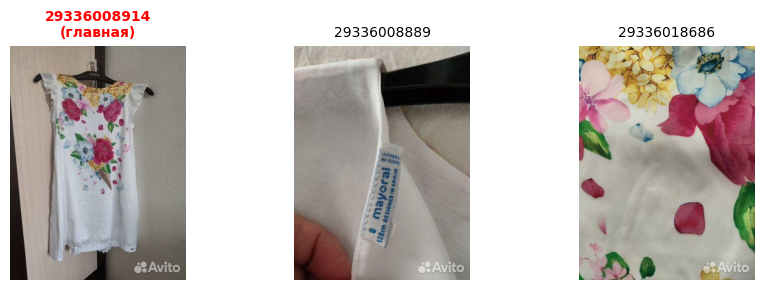


--- Объявление 89 (index=11524) ---
Title: Юбка школьная в клетку 122
Description: Юбка на 6-9 лет зависит от роста, с запахом можно регулировать толщину - цена 200р

блузка на возраст от 8-10 лет зависит от комплектации ребенка и роста - 200р
подробности в сообщении.
Category: (Ж) Платья и юбки
Attrs: {'Вид одежды': 'Юбки', 'Предмет одежды': 'Платья и юбки', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '122 см (7 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх, Низ'}


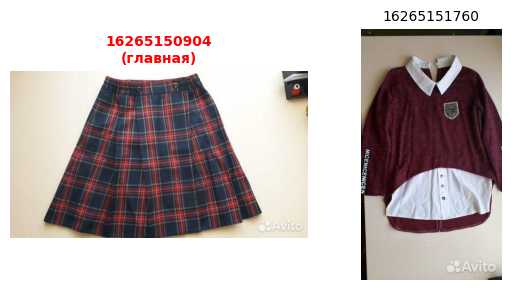


--- Объявление 90 (index=30032) ---
Title: Лонгслив для девочки 104
Description: Состояние нового. Без дефектов, пятен, дыр. Нарядная вещь. На горле нет застежки. Размер от производителя 116, маломерит, подходит 104-110
Category: (Ж) Футболки и топы
Attrs: {'Вид одежды': 'Футболки', 'Предмет одежды': 'Футболки и топы', 'Вид объявления': 'Продаю своё', 'Цвет': 'Белый', 'Размер. Одежда': '104 см (4 года)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх', 'Состояние от Авито': 'Как новое'}


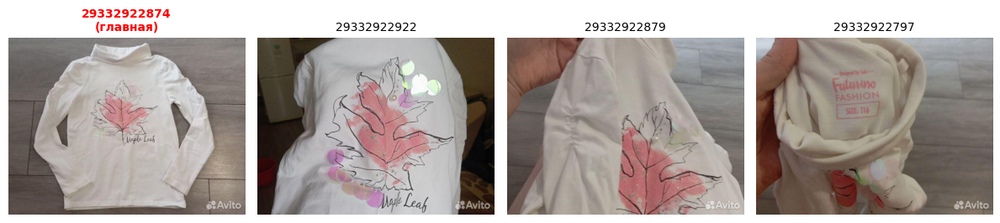


--- Объявление 91 (index=31156) ---
Title: Рубашка-боди 86 H&M
Description: Рубашечка-боди H&M в идеальном состоянии, размер 86. Покупали к дню рождения, один раз постирали и пролетели размером. Дефектов и нареканий нет. Ищет нового маленького хозяина!
Category: (М) Рубашки
Attrs: {'Предмет одежды': 'Рубашки', 'Вид одежды': 'Для мальчиков', 'Вид объявления': 'Продаю своё', 'Цвет': 'Белый', 'Размер. Одежда': '86 см (18 мес.)', 'Бренд одежды': 'H&M', 'Тип предмета одежды': 'Верх', 'Как часто надевали?': 'Один раз'}


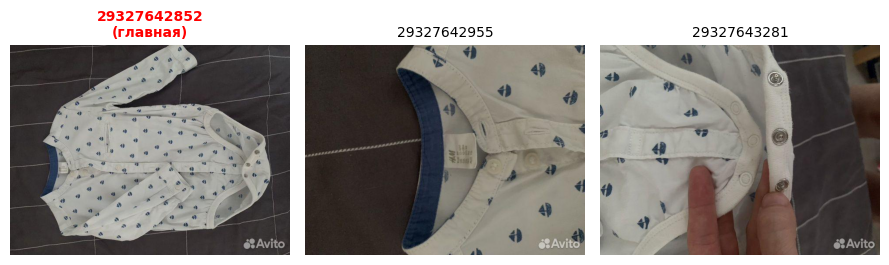


--- Объявление 92 (index=11449) ---
Title: Школьное платье серое 134
Description: платье школьное для девочки размер 128 -134 в идеальном состоянии. Покупали в детском  магазине юнионр .
Category: (Ж) Платья и юбки
Attrs: {'Вид одежды': 'Платья', 'Предмет одежды': 'Платья и юбки', 'Вид объявления': 'Продаю своё', 'Цвет': 'Серый', 'Размер. Одежда': '134 см (9 лет)', 'Бренд одежды': 'Без бренда', 'Тип предмета одежды': 'Верх, Низ', 'Как часто надевали?': 'Несколько раз'}


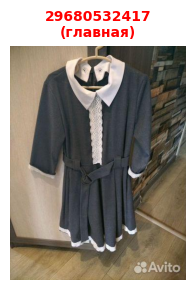


--- Объявление 93 (index=17120) ---
Title: Костюм зима 110-116см
Description: Продам костюм на девочку. Носили очень мало, один сезон, состояние идеальное. Мембрана, непродуваемая, водонепроницаемый.
Category: (Ж) Пиджаки и костюмы
Attrs: {'Вид одежды': 'Для девочек', 'Предмет одежды': 'Пиджаки и костюмы', 'Вид объявления': 'Продаю своё', 'Цвет': 'Разноцветный', 'Размер. Одежда': '116 см (6 лет)', 'Бренд одежды': 'Tokka Tribe', 'Тип предмета одежды': 'Верх, Низ', 'Тип одежды': 'Костюм'}


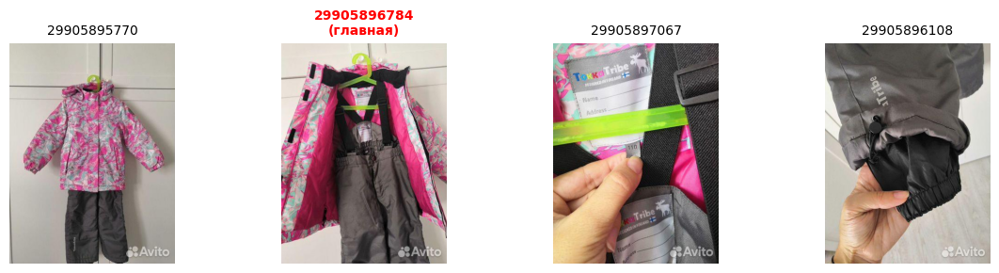


--- Объявление 94 (index=3589) ---
Title: Зимний комбинезон для девочки 80
Description: Зимний комбинезон очень теплый в хорошем состоянии, внутри овечий мех, который отстегивается. Овечьи носочки и кроличья шапка прилагается.
Category: (Ж) Комбинезоны
Attrs: {'Вид одежды': 'Утеплённые комбинезоны', 'Предмет одежды': 'Комбинезоны', 'Состояние': 'Как новое', 'Вид объявления': 'Продаю своё', 'Цвет': 'Розовый', 'Размер. Одежда': '80 см (12 мес.)', 'Бренд одежды': 'Без бренда', 'Тип предмета одежды': 'Верх, Низ', 'Состояние от Авито': 'Как новое'}


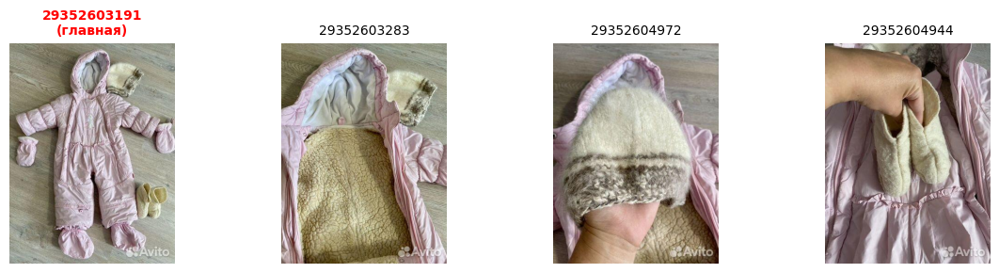


--- Объявление 95 (index=3705) ---
Title: Зимний комбинезон 74
Description: зимний комбинезон для девочки 62-74 размер , ножки отстегиваются , сьемный подклад с содержанием шерсти . комбинезон в хорошем состоянии
Category: (Ж) Комбинезоны
Attrs: {'Вид одежды': 'Утеплённые комбинезоны', 'Предмет одежды': 'Комбинезоны', 'Вид объявления': 'Продаю своё', 'Цвет': 'Бежевый', 'Размер. Одежда': '74 см (9 мес.)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх, Низ', 'Что сохранилось?': 'Бирки', 'Как часто надевали?': 'Несколько раз'}


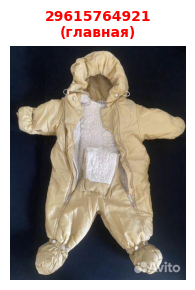


--- Объявление 96 (index=21775) ---
Title: Кофта джемпер
Description: Джемпер , кофта с капюшоном 
Для девочки или  девушки 
Очень приятного голубого цвета , хорошего приятного качества 
Новая , ни разу никто не носил
Category: (Ж) Свитеры и толстовки
Attrs: {'Вид одежды': 'Кофты', 'Предмет одежды': 'Свитеры и толстовки', 'Вид объявления': 'Продаю своё', 'Цвет': 'Голубой', 'Размер. Одежда': '158 см (13 лет)', 'Бренд одежды': 'Без бренда', 'Тип предмета одежды': 'Верх', 'Тип одежды': 'Кофта', 'Что сохранилось?': 'Бирки'}


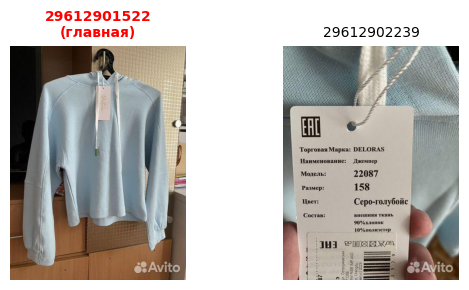


--- Объявление 97 (index=26344) ---
Title: Футболки Аниме 116см (5-6 лет)
Description: Новые с этикетками футболки для девочек - фанаток Аниме. 

Размер у всех 116см, на 5-6 лет. Хлопок. 

Одна - 300р. от 2 шт  по 250 р. 

Любая отправка))
Category: (Ж) Футболки и топы
Attrs: {'Вид одежды': 'Футболки', 'Предмет одежды': 'Футболки и топы', 'Состояние': 'Новый', 'Вид объявления': 'Продаю своё', 'Размер. Одежда': '116 см (6 лет)', 'Бренд одежды': 'Gloria Jeans', 'Тип предмета одежды': 'Верх', 'Что сохранилось?': 'Бирки, Ярлыки'}


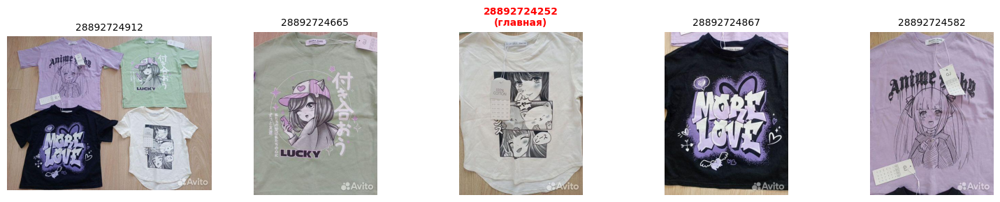


--- Объявление 98 (index=13179) ---
Title: Школьный сарафан 128-134.Alisia Fiori
Description: Школьный сарафан ,состав шерсть 75,эластан 25.Очень удобный сарафан,лиф на подкладке,юбка держит форму.Не мнется.Подойдет на девочку 7-8 лет.Эффектный бант на талии.Одевали не много,к сожалению стал мал.Покупали в фирменном магазине.Сейчас не выпускают из ткани с таким составом.
Category: (Ж) Платья и юбки
Attrs: {'Вид одежды': 'Платья', 'Предмет одежды': 'Платья и юбки', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Цвет': 'Синий', 'Размер. Одежда': '128 см (8 лет)', 'Бренд одежды': 'Другой', 'Тип предмета одежды': 'Верх, Низ'}


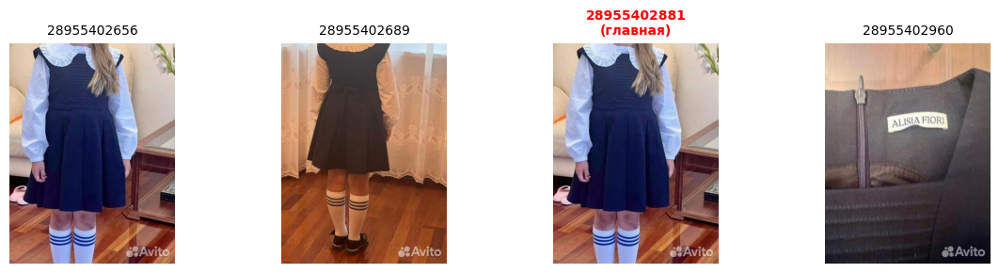


--- Объявление 99 (index=21141) ---
Title: Продам летний детский комбинезон
Description: продам комбинезон ,подойдёт как для мальчика так и для девочки.
Абсолютно новый,к сожалению бирки не сохранилось,но ни разу не одевали!состояние отличное
Category: (Ж) Брюки
Attrs: {'Вид одежды': 'Шорты', 'Предмет одежды': 'Брюки', 'Состояние': 'Б/у', 'Вид объявления': 'Продаю своё', 'Размер. Одежда': '74 см (9 мес.)', 'Бренд одежды': 'Без бренда', 'Тип предмета одежды': 'Низ'}


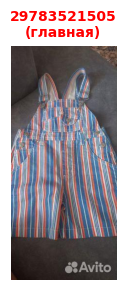


--- Объявление 100 (index=35489) ---
Title: Рубашка для мальчика 134
Description: Рубашка бренда brostem, 100% хлопок, на кнопках, приталенная. в идеальном состоянии. брака нет. цена символическая.
Category: (М) Рубашки
Attrs: {'Предмет одежды': 'Рубашки', 'Вид одежды': 'Для мальчиков', 'Вид объявления': 'Продаю своё', 'Цвет': 'Белый', 'Размер. Одежда': '134 см (9 лет)', 'Бренд одежды': 'Brostem', 'Тип предмета одежды': 'Верх', 'Как часто надевали?': 'Несколько раз'}


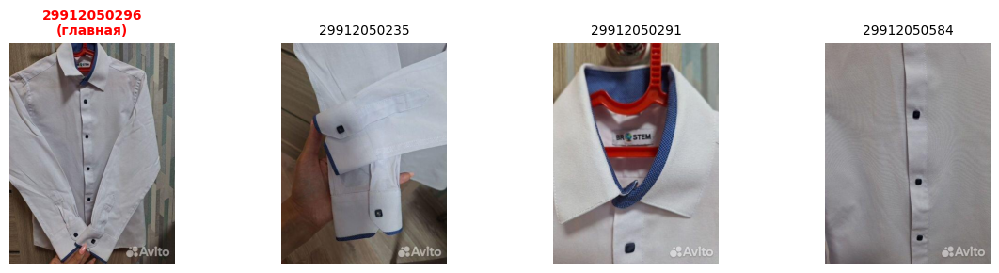

In [25]:

def show_ads(df, images_folder, k=5, random_state=42):
    random.seed(random_state)
    sample_indices = random.sample(list(df.index), k)
    
    for i, idx in enumerate(sample_indices):
        row = df.loc[idx]
        print(f"\n--- Объявление {i+1} (index={idx}) ---")
        if 'title' in row and pd.notnull(row['title']):
            print(f"Title: {row['title']}")
        if 'description' in row and pd.notnull(row['description']):
            print(f"Description: {row['description']}")
        if 'category' in row and pd.notnull(row['category']):
            print(f"Category: {row['category']}")
        if 'attrs' in row and pd.notnull(row['attrs']):
            print(f"Attrs: {row['attrs']}")

        try:
            image_ids = ast.literal_eval(row['images'])
        except Exception:
            image_ids = row['images']
        main_img_id = row['main_img']
        images = []
        for img_id in image_ids:
            img_path = os.path.join(images_folder, f"{img_id}.jpg")
            if os.path.isfile(img_path):
                try:
                    images.append(Image.open(img_path).convert('RGB'))
                except Exception:
                    images.append(None)
            else:
                images.append(None)
        n_imgs = len(images)

        fig, axs = plt.subplots(1, n_imgs, figsize=(3 * n_imgs, 3))
        if n_imgs == 1:
            axs = [axs]
        for j, (ax, img, img_id) in enumerate(zip(axs, images, image_ids)):
            ax.axis('off')
            if img is not None:
                ax.imshow(img)

            if img_id == main_img_id:
                ax.set_title(f"{img_id}\n(главная)", color='red', fontsize=10, fontweight='bold')
            else:
                ax.set_title(str(img_id), color='black', fontsize=10)
        plt.tight_layout()
        plt.show()


show_ads(df_samp, IMAGES, k=100, random_state=42)